# Pre-Start Procedures

## Import Statements (Always Run)

In [1]:
# customary imports:
import tensorflow as tf
assert '2.' in tf.__version__  # make sure you're using tf 2.0
import numpy as np
import matplotlib.pyplot as plt
import math
import string
import pandas as pd
import sklearn
import skimage
import cv2 as cv
import os
import re
import datetime
import scipy
from skimage.morphology import reconstruction
from skimage import exposure
import scipy.io as sio
import seaborn as sns
import h5py
import random
import shutil
import PIL
import imageio
import copy
import pydot 
import graphviz
import plotly.graph_objects as go
import preprocess_crop
from pathlib import Path
from tensorflow.keras import backend as K
from PIL import Image
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Flatten, Conv2D
from tensorflow.keras import Model
#from keras.utils import CustomObjectScope
from mpl_toolkits.mplot3d import Axes3D
print('Tensorflow version: ' + tf.__version__)
%matplotlib inline
%load_ext tensorboard

Using TensorFlow backend.


Tensorflow version: 2.1.0


In [2]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


## *If Running In Colab* - Run the Next Two Blocks

In [3]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
your_drive_dir = 'YourGoogleDriveDirectoryPath'
os.chdir('/content/drive/' + your_drive_dir)
print("Current Working Directory is : " + os.getcwd())

# Data Preprocessing - Do not run if data folders already established

## Function to Convert .mat folder into Another File Format

In [2]:
# Import Statements
from data_preprocessing_utils import convert_MAP

In [ ]:
raw_directory = os.path.join(os.getcwd(), 'raw_data')
MIN_SHAPE = (128,128)
ENDPOINT_FOLDER_NAME = 'converted_data'
converted_dir = convert_MAP(raw_directory, ENDPOINT_FOLDER_NAME, MIN_SHAPE,
                            file_format = '.npy', search_keys = ['map_532'])

## Function to Process Data by Denoising and Increasing Contrast

In [ ]:
# Import Statements:
from data_preprocessing_utils import data_clean_func
from data_preprocessing_utils import data_cleaning

In [3]:
input_dir_name = 'converted_data'
#dir_name = 'test_data'
input_data_dir = os.path.join(os.getcwd(), input_dir_name)
print('Starting Data Cleaning...')
data_cleaning(input_dir = input_data_dir, output_dir_name = 'cleaned_data',
                  output_file_format ='.tiff', delete_previous = True)
print('Ending Data Cleaning')

Starting Data Cleaning...
Ending Data Cleaning


## Function to Seperate Folder into Subfolder of /training /validation and /testing

In [6]:
# Import Statements:
from data_preprocessing_utils import data_seperation

In [7]:
input_dir = 'cleaned_data'
dataset_percentages = (80, 10, 10)
print('Starting Data Seperation...')
train_dir, val_dir, test_dir = data_seperation(input_dir, dataset_percentages, 
                                               delete_previous = True, file_format = '.tif', 
                                               scale = 2**16)
print('Ending Data Seperation...')

Starting Data Seperation...
Ending Data Seperation...


### Code Block to Show How Much of Data has been Placed in various Subfolders (train/val/test)

In [8]:
print('Length of raw_data directory = '+str(len(os.listdir('raw_data'))))
print('Length of converted_data directory = '+str(len(os.listdir('converted_data'))))
print('Rejected Files = ' + str(len(os.listdir('raw_data')) - len(os.listdir('converted_data'))))
print('Length of cleaned_data directory = '+str(len(os.listdir('cleaned_data'))))
print('Length of training directory = '+str(len(os.listdir(train_dir))))
print('Length of validation directory = '+str(len(os.listdir(val_dir))))
print('Length of test directory = '+str(len(os.listdir(test_dir))))

Length of raw_data directory = 391
Length of converted_data directory = 294
Rejected Files = 97
Length of cleaned_data directory = 294
Length of training directory = 235
Length of validation directory = 30
Length of test directory = 29


# Data Loading

## Padding Training Data and Adding Downsampled Image as Channel

In [96]:
# Import Statements:
from standardize_dir_utils import pad_img_and_add_down_channel
from standardize_dir_utils import standardize_dir

In [11]:
input_dir = 'data/train/input'
STANDARD_IMAGE_SHAPE = (128,128,1)
total_train_image_pool = standardize_dir(input_dir = input_dir, downsample_axis = 'x', downsample_ratio = [1,5], 
                                         standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif')
print('total_train_image_pool = ' + str(total_train_image_pool))

total_train_image_pool = 235


In [12]:
input_dir = 'data/val/input'
STANDARD_IMAGE_SHAPE = (128,128,1)
total_val_image_pool = standardize_dir(input_dir = input_dir, downsample_axis = 'x', downsample_ratio = [1,5], 
                                       standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif')
print('total_val_image_pool = ' + str(total_val_image_pool))

total_val_image_pool = 30


In [13]:
input_dir = 'data/test/input'
STANDARD_IMAGE_SHAPE = (128,128,1)
total_test_image_pool = standardize_dir(input_dir = input_dir, downsample_axis = 'x', downsample_ratio = [1,5], 
                                        standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif')
print('total_test_image_pool = ' + str(total_test_image_pool))

total_test_image_pool = 29


# Model Testing and Training - Run After this Point if Restarting Kernel (and you have re-run the import statements)

## Data Loader and Augmentation

In [12]:
from data_aug_funcs import preprocess_function
from data_aug_funcs import preprocess_function_valtest
from data_aug_funcs import add_gaussian_noise

In [13]:
STANDARD_IMAGE_SHAPE = (128,128,1) # See Above Section to Verify Shape
MIN_SHAPE = (STANDARD_IMAGE_SHAPE[0],STANDARD_IMAGE_SHAPE[1])
BATCH_SIZE = 16
train_dir = 'data/train'
val_dir = 'data/val'
test_dir = 'data/test'
seed = 7
tf.random.set_seed(seed)

In [14]:
data_gen_args_train = dict(horizontal_flip=True,
                           vertical_flip = True,
                           rotation_range=20,
                           width_shift_range=0.2,
                           height_shift_range=0.2,
                           shear_range=0.2,
                           fill_mode = 'constant',
                           cval = 0,
                           preprocessing_function = preprocess_function,
                           dtype='float32')
train_datagen = ImageDataGenerator(**data_gen_args_train)
data_gen_args_test_and_val = dict(preprocessing_function = preprocess_function_valtest)
test_and_val_datagen = ImageDataGenerator(**data_gen_args_test_and_val)
# Flow From Directory Generators
train_generator = train_datagen.flow_from_directory(train_dir,
                                                    target_size=MIN_SHAPE,
                                                    batch_size=BATCH_SIZE,
                                                    class_mode=None,
                                                    ####################
                                                    # Monkey Patch - preprocess_crop.py
                                                    interpolation = 'lanczos:random',
                                                    ####################
                                                    color_mode='rgb',
                                                    shuffle = True, 
                                                    seed=seed)

validation_generator = test_and_val_datagen.flow_from_directory(val_dir,
                                                                target_size=MIN_SHAPE,
                                                                batch_size=BATCH_SIZE,
                                                                class_mode=None,
                                                                ####################
                                                                # Monkey Patch - preprocess_crop.py
                                                                interpolation = 'lanczos:random',
                                                                ####################
                                                                color_mode='rgb',
                                                                shuffle = True, 
                                                                seed=seed)
test_generator = test_and_val_datagen.flow_from_directory(test_dir,
                                                          target_size=MIN_SHAPE,
                                                          batch_size=BATCH_SIZE,
                                                          class_mode=None,
                                                          ####################
                                                          # Monkey Patch - preprocess_crop.py
                                                          interpolation = 'lanczos:center', 
                                                          ####################
                                                          color_mode='rgb', 
                                                          shuffle = False,
                                                          seed=seed)

Found 233 images belonging to 1 classes.
Found 30 images belonging to 1 classes.
Found 29 images belonging to 1 classes.


In [15]:
def custom_generator_wrapper(gen):
    '''
    This wrapper function ensures that the downsampled data and ground truth
    stay coaligned during the random crop step.
    '''
    for data in gen:
        orig_img = data[...,0] # target
        down_img = data[...,1] # input
        # Third channel is empty and only there for compatibility
        yield down_img[..., None], orig_img[..., None]

## Model Definition for U-Net

In [16]:
'''
# Model Subclassing
from UNet_model_simp import UNet_model_simp
'''

# USING FUNCTIONAL API

#from UNet_model_simp_func import getModel
#from ResUNet import getModel
#from ICL_ResUNet import getModel
from FD_UNet import getModel

from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
from model_utils import model_loss_experimental

### Hyperparameters

In [17]:
EPOCHS = 500 #350
FILTERS = 64
INITIAL_LR = 0.001
ACTIVATION = 'elu'
KERNEL_SIZE = 3 # 3x3 kernel
AUGMENTATIONS = 10
VAL_AUGMENTATIONS = 10
B1 = 1.0
B2 = 0.01
#B3 = 1/30
#B4 = 0.0

### Compiling and Training Model

In [18]:
# Subclassed Model
#unet_model = UNet_model_simp(filters = FILTERS, kernel_size = KERNEL_SIZE, activation = ACTIVATION)

In [19]:
# Functional API Model
unet_model = getModel(input_shape=STANDARD_IMAGE_SHAPE, filters=FILTERS, kernel_size=KERNEL_SIZE, activation=ACTIVATION)

In [20]:
#unet_model = saved_model
#unet_model = best_unet_model
unet_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = INITIAL_LR, amsgrad=False),  # pick an optimizer
                   loss=model_loss(B1,B2),  # pick a loss
                   #loss=model_loss_experimental(B1,B2,B3),
                   metrics=['mean_absolute_error', 'mean_squared_error', KLDivergence, SavingMetric, PSNR, SSIM])  # pick a metric to monitor

In [ ]:
train_dir = 'data/train/input'
val_dir = 'data/val/input'
model_dir = 'model_dir'
delete_previous=True

if not os.path.exists(model_dir):
            os.mkdir(model_dir)
elif delete_previous:
            shutil.rmtree(model_dir)
            os.mkdir(model_dir)

my_callbacks = [tf.keras.callbacks.ModelCheckpoint(filepath = os.path.join(model_dir, 'saved_model.epoch_{epoch:02d}-SSIM_{val_SSIM:.5f}-PSNR_{val_PSNR:.5f}-metric_{val_SavingMetric:.5f}.h5'),
                                                   monitor='val_SavingMetric', verbose=0, 
                                                   save_best_only=True, save_weights_only=False, 
                                                   mode='min', save_freq='epoch')]

history = unet_model.fit(custom_generator_wrapper(train_generator),
                         steps_per_epoch=AUGMENTATIONS*np.ceil(len(os.listdir(train_dir))/BATCH_SIZE),
                         epochs=EPOCHS,
                         callbacks=my_callbacks, 
                         validation_data=custom_generator_wrapper(validation_generator),
                         validation_steps=VAL_AUGMENTATIONS*np.ceil(len(os.listdir(val_dir))/BATCH_SIZE), 
                         max_queue_size = 256,
                         shuffle = True)

### Load the Best Model From Model Dir

In [27]:
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
print('Loading Best Model...')
model_dir = 'model_dir'
filename = sorted(os.listdir(model_dir), key = lambda x : int(x.partition('h_')[2].partition('-S')[0]))[-1]
directory = os.path.join(os.getcwd(), model_dir)
directory = os.path.join(directory, filename)
saved_model = tf.keras.models.load_model(directory, custom_objects={'model_loss':model_loss,'loss_func':model_loss(B1=0.99,B2=0.01), 
                                                                        'PSNR':PSNR, 'SSIM':SSIM, 'KLDivergence':KLDivergence, 
                                                                        'SavingMetric':SavingMetric})
print('Done Loading Best Model(' + filename + ') from: ' + model_dir)

Loading Best Model...
Done Loading Best Model(saved_model.epoch_122-SSIM_0.80607-PSNR_23.08711-metric_0.25543.h5) from: model_dir


## Analysis of Model Training History

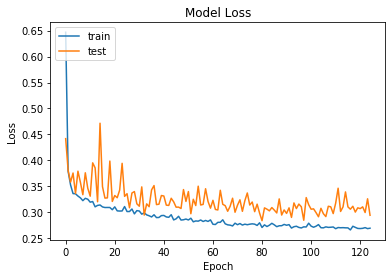

In [26]:
offset = 0
data1 = history.history['loss'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_loss'][offset:]
plt.plot(epochs, data2)
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

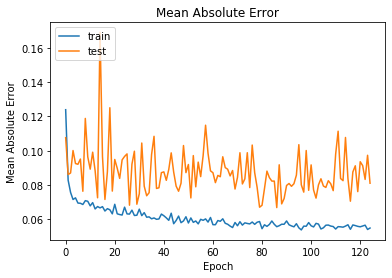

In [27]:
offset = 0
data1 = history.history['mean_absolute_error'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_mean_absolute_error'][offset:]
plt.plot(epochs, data2)
plt.title('Mean Absolute Error')
plt.ylabel('Mean Absolute Error')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

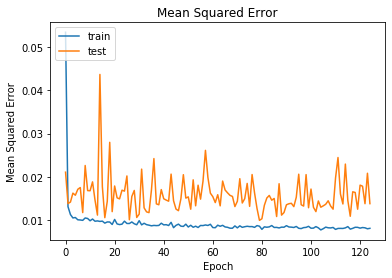

In [28]:
offset = 0
data1 = history.history['mean_squared_error'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_mean_squared_error'][offset:]
plt.plot(epochs, data2)
plt.title('Mean Squared Error')
plt.ylabel('Mean Squared Error')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

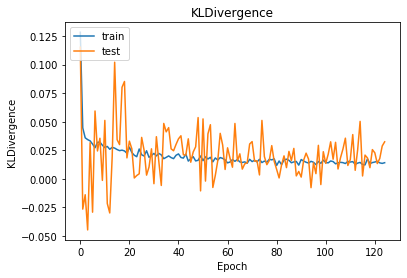

In [29]:
offset = 0
data1 = history.history['KLDivergence'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_KLDivergence'][offset:]
plt.plot(epochs, data2)
plt.title('KLDivergence')
plt.ylabel('KLDivergence')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

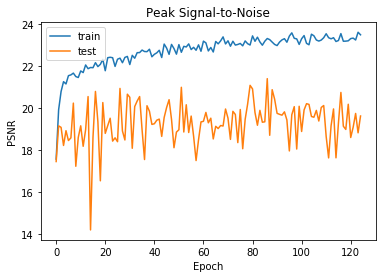

In [30]:
offset = 0
data1 = history.history['PSNR'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_PSNR'][offset:]
plt.plot(epochs, data2)
plt.title('Peak Signal-to-Noise')
plt.ylabel('PSNR')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

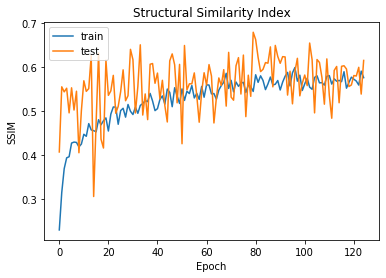

In [31]:
offset = 0
data1 = history.history['SSIM'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_SSIM'][offset:]
plt.plot(epochs, data2)
plt.title('Structural Similarity Index')
plt.ylabel('SSIM')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

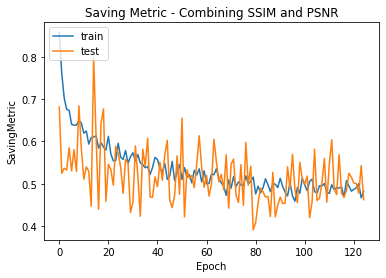

In [32]:
offset = 0
data1 = history.history['SavingMetric'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_SavingMetric'][offset:]
plt.plot(epochs, data2)
plt.title('Saving Metric - Combining SSIM and PSNR')
plt.ylabel('SavingMetric')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

### Model Architecture

In [ ]:
unet_model.summary()

In [ ]:
tf.keras.utils.plot_model(unet_model, 'saved_model_UNet_1i-5j_down/unet_arch_TB.png', show_shapes=True, rankdir='TB', dpi=300)

## Save Model

### Option A - For Functional API

In [38]:
def save_history(history, output_dir):
    directory = os.path.join(os.getcwd(), output_dir)
    if not os.path.exists(directory):
        os.mkdir(directory)
    filepath = os.path.join(directory, 'history')
    np.savez(filepath, **history.history)

In [40]:
# Using Functional API
output_dir = 'saved_model_FD_UNet_3i-7j_down'
filename = 'saved_model.h5'
if not os.path.exists(os.path.join(os.getcwd(), output_dir)):
    print('Creating Directory...')
    os.mkdir(os.path.join(os.getcwd(), output_dir))
else:
    print('Directory Already Exists...')
print('Saving Latest Model...')
directory = os.path.join(os.getcwd(), output_dir)
directory = os.path.join(directory, filename)
unet_model.save(directory)
print('Saving History...')
save_history(history, output_dir)
best_model_dir = os.path.join(output_dir, 'best_models')
if not os.path.exists(best_model_dir):
    print('Creating Best Models Directory...')
    os.mkdir(best_model_dir)
else:
    print('Best Models Directory Already Exists...')
print('Saving Best Model...')
model_dir = 'model_dir'

filename = sorted(os.listdir(model_dir), key = lambda x : int(x.partition('h_')[2].partition('-S')[0]))[-1]
directory = os.path.join(os.getcwd(), model_dir)
directory = os.path.join(directory, filename)
os.rename(directory, os.path.join(best_model_dir, filename))
filename = sorted(os.listdir(model_dir), key = lambda x : int(x.partition('h_')[2].partition('-S')[0]))[-1]
directory = os.path.join(os.getcwd(), model_dir)
directory = os.path.join(directory, filename)
os.rename(directory, os.path.join(best_model_dir, filename))
print('Done Saving !!!')

Directory Already Exists...
Saving Latest Model...
Saving History...
Best Models Directory Already Exists...
Saving Best Model...
Done Saving !!!


### Option B - For Keras Subclassing

In [19]:
def save_history(history, output_dir):
    directory = os.path.join(os.getcwd(), output_dir)
    if not os.path.exists(directory):
        os.mkdir(directory)
    filepath = os.path.join(directory, 'history')
    np.savez(filepath, **history.history)

In [ ]:
# Using Keras Subclassing
output_dir = 'saved_model_FD_UNet_3i-7j_down'
if not os.path.exists(os.path.join(os.getcwd(), output_dir)):
    print('Creating Directory...')
    os.mkdir(os.path.join(os.getcwd(), output_dir))
#unet_model.trainable = False
print('Saving Model...')
tf.keras.models.save_model(unet_model,
                           output_dir,
                           overwrite=True,
                           include_optimizer=True,
                           save_format='tf',
                           signatures=None,
                           options=None)
print('Saving History...')
save_history(history, output_dir)
print('Done Saving')

## Load Model (only for prediction/inference with Keras Subclassing)

### Option A - For Functional API

### For Functional API - Best Model State

In [3]:
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
print('Loading Model...')
input_dir = 'saved_model_FD_UNet_1i-5j_down\\best_models'
filename = sorted(os.listdir(input_dir), key = lambda x : int(x.partition('h_')[2].partition('-S')[0]))[-1]
directory = os.path.join(os.getcwd(), input_dir)
directory = os.path.join(directory, filename)
saved_model = tf.keras.models.load_model(directory, custom_objects={'model_loss':model_loss,'loss_func':model_loss(B1=0.99,B2=0.01), 
                                                                    'PSNR':PSNR, 'SSIM':SSIM, 'KLDivergence':KLDivergence, 
                                                                    'SavingMetric':SavingMetric})
print('Done Loading Best Model (' + filename + ') from: ' + input_dir)

Loading Model...
Done Loading Best Model (saved_model.epoch_428-SSIM_0.93472-PSNR_29.52073-metric_0.09268.h5) from: saved_model_FD_UNet_1i-5j_down\best_models


### For Functional API - Latest Model State

In [ ]:
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
print('Loading Model...')
input_dir = 'saved_model_FD_UNet_3i-7j_down'
filename = 'saved_model.h5'
directory = os.path.join(os.getcwd(), input_dir)
directory = os.path.join(directory, filename)
saved_model = tf.keras.models.load_model(directory, custom_objects={'model_loss':model_loss,'loss_func':model_loss(B1=0.99,B2=0.01), 
                                                                    'PSNR':PSNR, 'SSIM':SSIM, 'KLDivergence':KLDivergence, 
                                                                    'SavingMetric':SavingMetric})
print('Done Loading Latest Model ' + filename + ' from: ' + input_dir)

#### Load History From File

In [ ]:
from history_utils import load_history_from_saved
input_dir = 'saved_model_FD_UNet_3i-7j_down'
saved_hist = load_history_from_saved(input_dir)

#### Show History

In [ ]:
from history_utils import show_history
show_history(saved_hist, offset=50)

### Option B - For Keras Subclassing

#### Copy and Paste Hyperparameters Used (From Text File)

In [185]:
from UNet_model_simp import UNet_model_simp

EPOCHS = 500
FILTERS = 64
INITIAL_LR = 0.001
ACTIVATION = 'elu'
KERNEL_SIZE = 3 # 3x3 kernel

In [186]:
token = UNet_model_simp(filters = FILTERS, kernel_size = KERNEL_SIZE, activation = ACTIVATION)
token.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = INITIAL_LR),  # pick an optimizer
              loss=token.loss_func,  # pick a loss
              metrics=['mean_absolute_error'])  # pick a metric to monitor
hist_tok = token.fit_generator(custom_generator_wrapper(train_generator),
                               steps_per_epoch=1,#np.ceil(len(os.listdir(train_dir))/ BATCH_SIZE),
                               epochs=1,
                               validation_data=custom_generator_wrapper(validation_generator),
                               validation_steps=1,#np.ceil(len(os.listdir(val_dir))/ BATCH_SIZE),
                               shuffle = True)

1/1 [==============================] - 4s 4s/step - loss: 1.1236 - mean_absolute_error: 1.1236 - val_loss: 0.2689 - val_mean_absolute_error: 0.2689


In [ ]:
from UNet_model_simp import UNet_model_simp
from UNet_model_simp import UNet_DownBlock
from UNet_model_simp import UNet_UpBlock
from UNet_model_simp import Conv2D_BatchNorm
from UNet_model_simp import Upsample_Conv2D_BatchNorm
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
print('Loading Model...')
custom_objects={'UNet_DownBlock' : UNet_DownBlock,
                'UNet_UpBlock' : UNet_UpBlock,
                'Conv2D_BatchNorm' : Conv2D_BatchNorm,
                'Upsample_Conv2D_BatchNorm' : Upsample_Conv2D_BatchNorm,
                'total_loss' : token.loss_func}
input_dir = 'saved_model_FD_UNet_3i-7j_down'
saved_model = tf.keras.models.load_model(input_dir, custom_objects = custom_objects, compile = False)
saved_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = INITIAL_LR),  # pick an optimizer
                    loss=token.loss_func,  # pick a loss
                    metrics=['mean_absolute_error', 'mean_squared_error', PSNR, SSIM])  # pick a metric to monitor
print('Done Loading Model from: ' + input_dir)

#### Load History From File

In [ ]:
from history_utils import load_history_from_saved
input_dir = 'saved_model_FD_UNet_3i-7j_down'
saved_hist = load_history_from_saved(input_dir)

#### Show History

In [ ]:
from history_utils import show_history
show_history(saved_hist, offset=50)

## Analysis of Model Output/Results

In [28]:
predictions_curr = saved_model.predict(custom_generator_wrapper(test_generator), steps = 1)
print(predictions_curr.shape)

(16, 128, 128, 1)


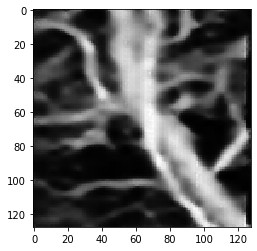

In [29]:
plt.imshow(predictions_curr[14,:,:,0], cmap = 'gray')
plt.show()

# Showing Results with Test Images (Zero-Fill Method):

### Downsampling the Image in testing/input directory

In [ ]:
# Import Statements:
from standardize_dir_utils import pad_img_and_add_down_channel
from standardize_dir_utils import standardize_dir

In [53]:
num_img = standardize_dir(input_dir = 'testing/input', downsample_axis = 'x', downsample_ratio = [0,5], 
                          standard_shape = (128,128,1), file_format = '.tif')

### Showing Results on Test Image

In [33]:
def preprocess_function_testing(image, shape = (128,128,1)):
    img = image.copy()
    #print(img.shape)
    img = exposure.rescale_intensity(img, in_range='image', out_range=(0.0,1.0))
    img = np.array(img, dtype = np.float32)
    #print(img.shape)
    #plt.imshow(img[:,:,0], cmap='gray')
    #plt.show()
    return img

In [34]:
data_gen_args_testing = dict(#featurewise_center=True,
                          #featurewise_std_normalization=True,
                          preprocessing_function = preprocess_function_testing)
testing_datagen = ImageDataGenerator(**data_gen_args_testing)

# Provide the same seed and keyword arguments to the fit and flow methods
testing_dir = 'testing'

testing_generator = testing_datagen.flow_from_directory(testing_dir,target_size=(128,128),
                                                        batch_size=1,class_mode=None,color_mode='rgb', shuffle = False)

Found 1 images belonging to 1 classes.


In [35]:
def custom_generator_wrapper(gen):
    for data in gen:
        orig_img = data[...,0] # target
        down_img = data[...,1] # input
        # Third channel is empty and only there for compatibility
        yield down_img[..., None], orig_img[..., None]

In [ ]:
dir_name = 'testing/input'
saved_model = best_unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print(filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
img = np.array(imageio.imread(filepath))
orig_img = img[...,0]
down_img = img[...,1]
mask = img[...,2]
pred = saved_model.predict_generator(custom_generator_wrapper(testing_generator), steps=1)
image = pred[0,:,:,0]

figsize = (7,7)
# Create a figure of the right size with one axes that takes up the full figure
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
# Hide spines, ticks, etc.
ax.axis('off')

ax.imshow(mask, cmap = 'gray')
print(mask.shape)
plt.show()
print('total elements in mask = '+ str(np.sum(mask>-1)))
print('total elements not downsampled = '+str(np.sum(mask)))
print('max value in mask = '+str(np.max(mask)))
print('min value in mask = '+str(np.min(mask)))
print('mean of mask = '+str(np.mean(mask)))

fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(down_img, cmap = 'gray')
plt.title('Downsampled Image')
plt.show()

fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(image, cmap = 'gray')
plt.title('Reconstructed Image')
plt.show()

fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(orig_img, cmap = 'gray')
plt.title('Original Image')
plt.show()

fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(np.abs(orig_img - image), cmap = 'gray') #ax.imshow(skimage.util.invert(np.abs(image - img/np.max(img))), cmap = 'gray')
plt.title('Absolute Difference Image')
plt.show()
print('Mean Absolute Difference: ' + str(np.mean(np.abs(orig_img - image))))
print('Max Absolute Difference: ' + str(np.max(np.abs(orig_img - image))))

# xx, yy = np.mgrid[0:image.shape[0], 0:image.shape[1]]
# fig = plt.figure(figsize=figsize)
# ax = fig.gca(projection='3d')
# ax.plot_surface(xx, yy, image, rstride=1, cstride=1, cmap=plt.cm.gray,linewidth=2)
# ax.view_init(80, 30)
# plt.show()

# Interactive 3-D Plot
img = np.flip(orig_img, axis = 0)
sh_0, sh_1 = img.shape
x, y = np.linspace(1, sh_0, sh_0), np.linspace(1, sh_0, sh_1)
fig = go.Figure(data=[go.Surface(z=img, x=x, y=y)])
fig.update_layout(title='Original Image', autosize=False,
                  width=500, height=500,
                  scene = dict(aspectratio=dict(x=1, y=1, z=0.5)),
                  margin=dict(l=65, r=50, b=65, t=90))

fig.show()

# Interactive 3-D Plot
image = np.flip(image, axis = 0)
sh_0, sh_1 = image.shape
x, y = np.linspace(1, sh_0, sh_0), np.linspace(1, sh_0, sh_1)
fig = go.Figure(data=[go.Surface(z=image, x=x, y=y)])
fig.update_layout(title='Reconstructed Image', autosize=False,
                  width=500, height=500,
                  scene = dict(aspectratio=dict(x=1, y=1, z=0.5)),
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()

# Applying Model to Larger Images and Testing Patchwork Algorithm Functions:

In [33]:
# Import Statements
import patchwork_alg
from patchwork_alg import expand_image
from patchwork_alg import fix_boundaries
from patchwork_alg import apply_model_patchwork

Directory:testing\input\brain_image_crop_1_128by128_pad.tif


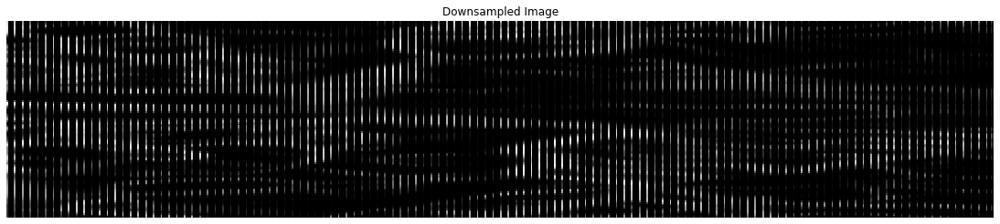

Augmented Shape: (128, 640)
20.2880859375 %


In [13]:
dir_name = 'testing\\input'
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory:' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
img = np.array(imageio.imread(filepath))
img = img[...,0]
full = expand_image(down_image = img, downsampling_ratio = [0,5], downsampling_axis = 'both')
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full, cmap = 'gray')
plt.title('Downsampled Image')
plt.show()
print('Augmented Shape: ' + str(full.shape))
print(str((np.sum(full>0)/(full.shape[0]*full.shape[1]))*100) + ' %')

Directory: testing\input\brain_image_crop_1_128by128_pad.tif


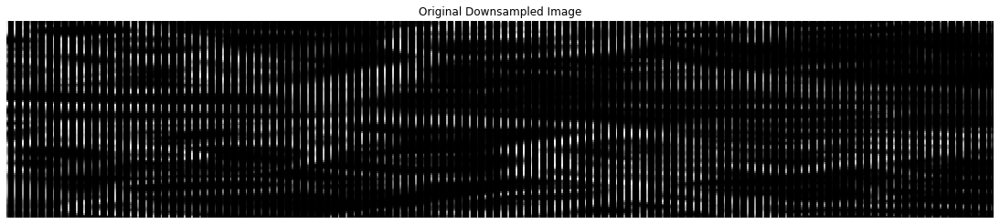

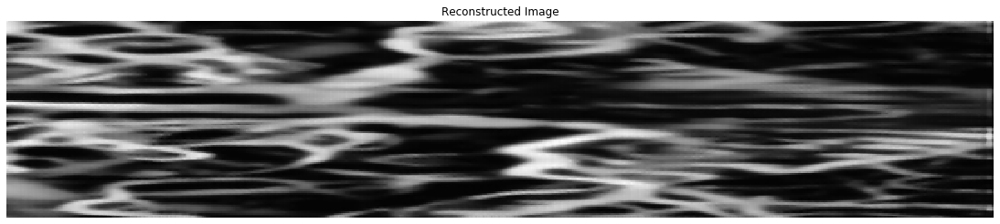

Augmented Shape: (128, 640)
20.2880859375 %


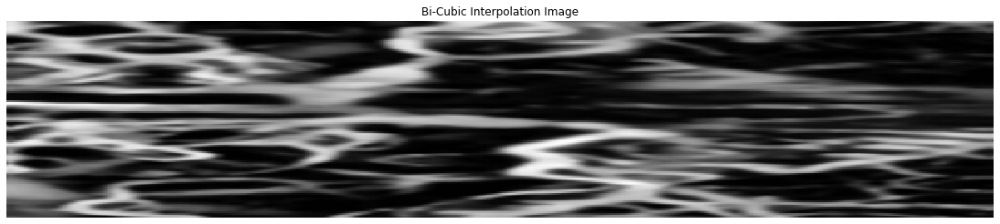

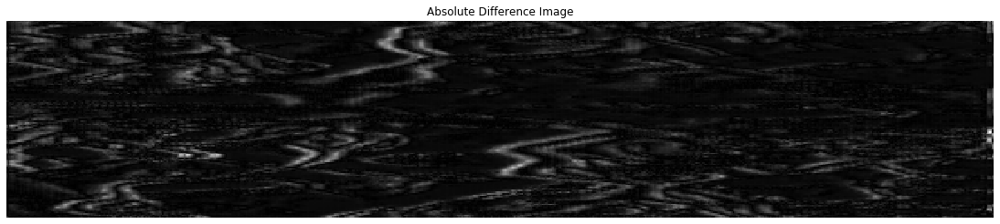

Mean Absolute Difference: 0.024715974287137243
Max Absolute Difference: 0.32969392629737


In [14]:
dir_name = 'testing\\input'
saved_model = best_unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
img = orig_img[...,0]
img = exposure.rescale_intensity(img, in_range='image', out_range=(0.0,1.0))
img = np.pad(img, [(0, 0), (0, 0)], mode='constant')
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
full = expand_image(down_image = img, downsampling_ratio = [1,5], downsampling_axis = 'both')
ax.imshow(full, cmap = 'gray')
plt.title('Original Downsampled Image')
plt.show()
full_image = apply_model_patchwork(saved_model, down_image = img, downsampling_ratio = [1,5], 
                                   downsampling_axis = 'both', shape_for_model = (128,128), buffer = 20)
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_image, cmap = 'gray')
plt.title('Reconstructed Image')
plt.show()
print('Augmented Shape: ' + str(full.shape))
print(str((np.sum(full>0)/(full.shape[0]*full.shape[1]))*100) + ' %')

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
i_expansion_ratio = 1
j_expansion_ratio = 5
interp_img = skimage.transform.resize(img, output_shape = (img.shape[0]*i_expansion_ratio,img.shape[1]*j_expansion_ratio), 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, anti_aliasing=True, 
                                      anti_aliasing_sigma=None)
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image')
plt.show()

# DIFFERENCE IMAGE:
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(np.abs(interp_img - full_image), cmap = 'gray')
plt.title('Absolute Difference Image')
plt.show()
print('Mean Absolute Difference: ' + str(np.mean(np.abs(interp_img - full_image))))
print('Max Absolute Difference: ' + str(np.max(np.abs(interp_img - full_image))))

Directory: testing\input\brain_image_crop_1_128by128_pad.tif


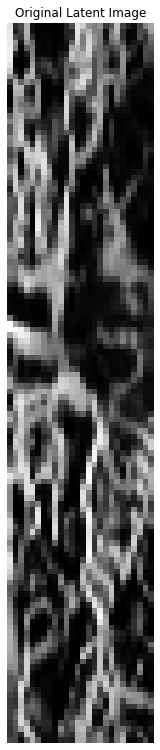

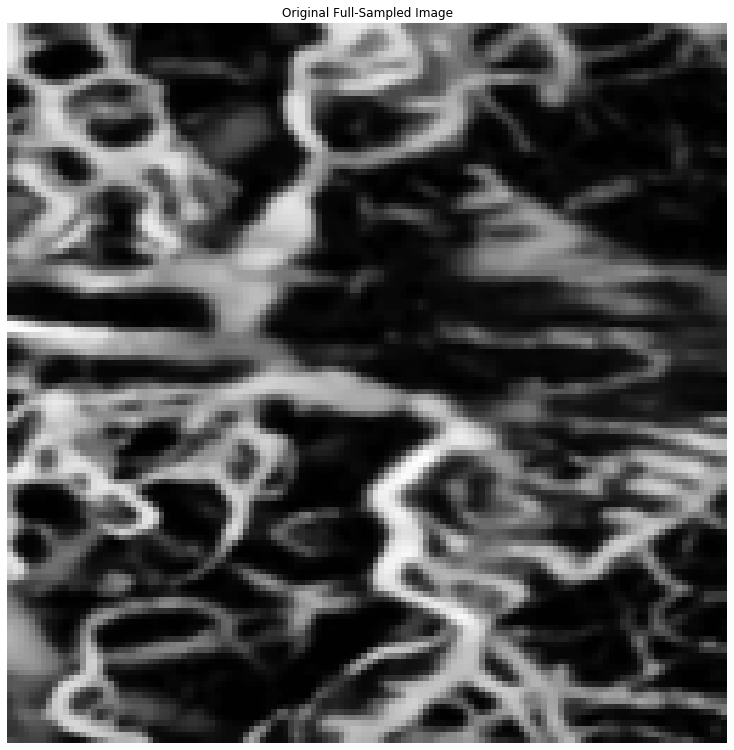

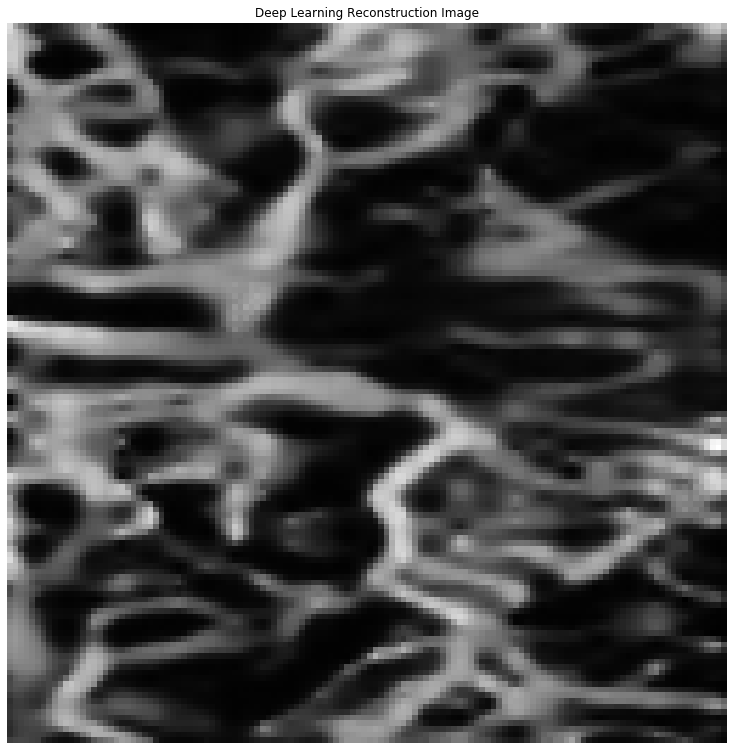

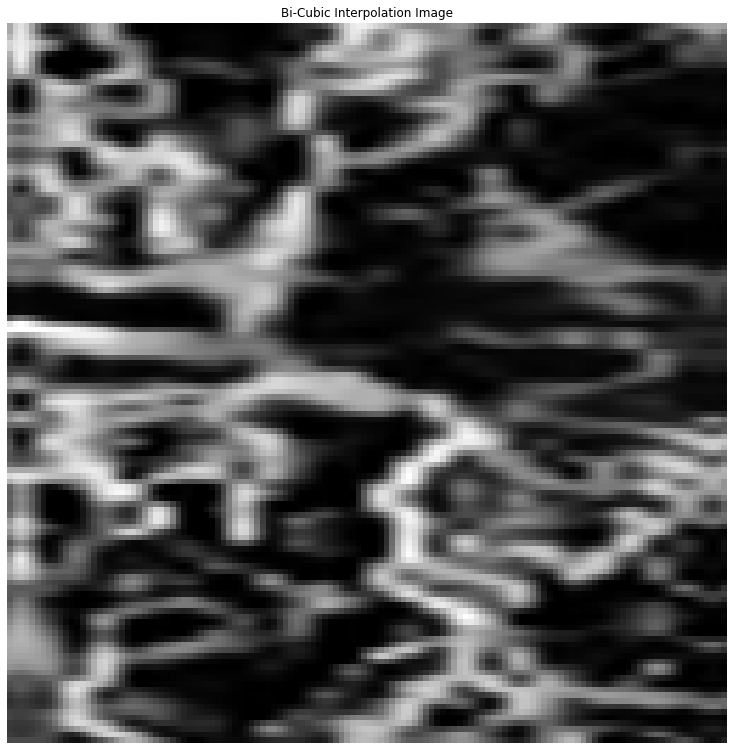

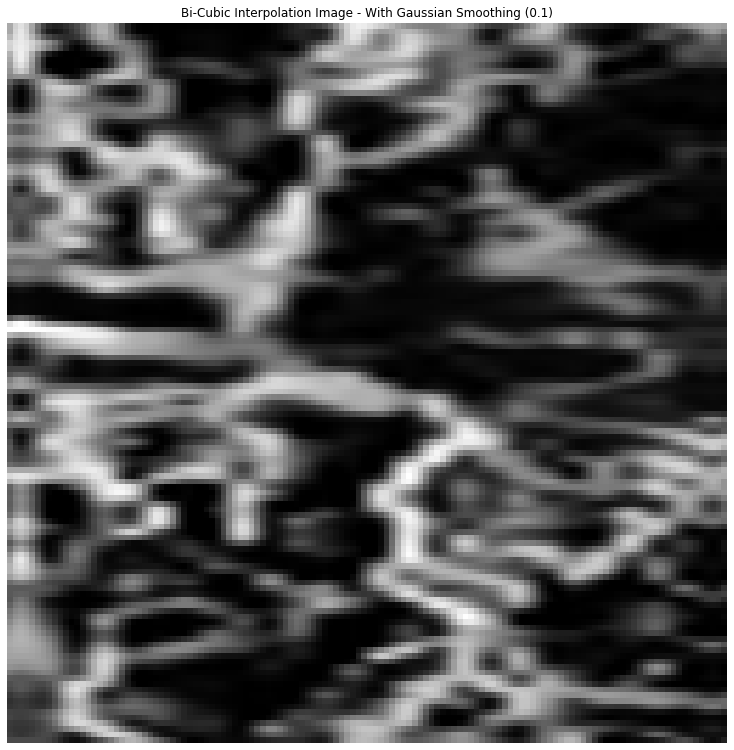

---------------------------------------
##########LIST OF STATISTICS:##########
---------------------------------------
COMPARISON OF PSNR:
Deep Learning: 20.959507
Bicubic Interp: 19.27721
COMPARISON OF SSIM:
Deep Learning: 0.8417628
Bicubic Interp: 0.78868335
COMPARISON OF MEAN ABSOLUTE ERROR:
Deep Learning: 0.05960998
Bicubic Interp: 0.066905364
COMPARISON OF MEAN SQUARED ERROR:
Deep Learning: 0.008017689
Bicubic Interp: 0.01181079
COMPARISON OF KL DIVERGENCE:
Deep Learning: 0.04600536
Bicubic Interp: 0.019096494
COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:
Deep Learning: 0.003932474
Bicubic Interp: 0.0063040997
COMPARISON OF LOG COSH ERROR:
Deep Learning: 0.0039767646
Bicubic Interp: 0.0058149975
COMPARISON OF POISSON LOSS:
Deep Learning: 0.52738166
Bicubic Interp: 0.540255


In [34]:
dir_name = 'testing\\input'
#saved_model = best_unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,0], in_range='image', out_range=(0.0,1.0))
down_samp_img = exposure.rescale_intensity(orig_img[...,1], in_range='image', out_range=(0.0,1.0))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
# Recover Latent Image:
downsampling_ratio = [1,5]
latent_image = np.zeros((int(np.ceil(down_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(down_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, down_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, down_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = down_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image, cmap = 'gray')
plt.title('Original Latent Image')
plt.show()

figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Original Full-Sampled Image')
plt.show()
deep_image = apply_model_patchwork(saved_model, down_image = latent_image, downsampling_ratio = [1,5], 
                                   downsampling_axis = 'both', shape_for_model = (128,128), 
                                   buffer = 20, output_shape = (128,128))
figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Deep Learning Reconstruction Image')
plt.show()

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
downsampling_ratio = [1,5]
interp_img = skimage.transform.resize(latent_image, output_shape=(128,128), 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, anti_aliasing=True, 
                                      anti_aliasing_sigma=None)
figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image')
plt.show()

gauss_interp_img = scipy.ndimage.gaussian_filter(interp_img, sigma=0.1, order=0, output=None, mode='reflect', cval=0.0, truncate=3.0)
interp_img = gauss_interp_img
figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(gauss_interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image - With Gaussian Smoothing (0.1)')
plt.show()

# Quantitative Measurements
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
#from model_utils import TV
deep_image = deep_image[..., None]
deep_image = tf.image.convert_image_dtype(deep_image[None, ...], tf.float32)
interp_img = interp_img[..., None]
interp_img = tf.image.convert_image_dtype(interp_img[None, ...], tf.float32)
full_samp_img = full_samp_img[..., None]
full_samp_img = tf.image.convert_image_dtype(full_samp_img[None, ...], tf.float32)
print('---------------------------------------')
print('##########LIST OF STATISTICS:##########')
print('---------------------------------------')
print('COMPARISON OF PSNR:')
print('Deep Learning: ' + str(PSNR(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(PSNR(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF SSIM:')
print('Deep Learning: ' + str(SSIM(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(SSIM(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF MEAN ABSOLUTE ERROR:')
MAE = tf.keras.losses.MeanAbsoluteError()
print('Deep Learning: ' + str(MAE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MAE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED ERROR:')
MSE = tf.keras.losses.MeanSquaredError()
print('Deep Learning: ' + str(MSE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSE(full_samp_img, interp_img).numpy()))
#print('COMPARISON OF TOTAL VARIATION:')
#print('Deep Learning: ' + str(TV(full_samp_img, deep_image).numpy()))
#print('Bicubic Interp: ' + str(TV(full_samp_img, interp_img).numpy()))
print('COMPARISON OF KL DIVERGENCE:')
print('Deep Learning: ' + str(KLDivergence(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(KLDivergence(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:')
MSLE = tf.keras.losses.MeanSquaredLogarithmicError()
print('Deep Learning: ' + str(MSLE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSLE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF LOG COSH ERROR:')
LCOSH = tf.keras.losses.LogCosh()
print('Deep Learning: ' + str(LCOSH(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(LCOSH(full_samp_img, interp_img).numpy()))
print('COMPARISON OF POISSON LOSS:')
PL = tf.keras.losses.Poisson()
print('Deep Learning: ' + str(PL(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(PL(full_samp_img, interp_img).numpy()))

# Testing Patchwork Algorithm (Zero-Fill Method) with Larger Images:

## Load Model

In [ ]:
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
print('Loading Model...')
input_dir = 'saved_model_FD_UNet_3i-7j_down\\best_models'
filename = sorted(os.listdir(input_dir), key = lambda x : int(x.partition('h_')[2].partition('-S')[0]))[-1]
directory = os.path.join(os.getcwd(), input_dir)
directory = os.path.join(directory, filename)
saved_model = tf.keras.models.load_model(directory, custom_objects={'model_loss':model_loss,'loss_func':model_loss(B1=0.99,B2=0.01), 
                                                                    'PSNR':PSNR, 'SSIM':SSIM, 'KLDivergence':KLDivergence, 
                                                                    'SavingMetric':SavingMetric})
print('Done Loading Best Model (' + filename + ') from: ' + input_dir)

In [4]:
# Import Statements
import patchwork_alg
from patchwork_alg import expand_image
from patchwork_alg import fix_boundaries
from patchwork_alg import apply_model_patchwork
from patchwork_alg import remove_peak
from patchwork_alg import remove_padding

Directory: patchwork_test\reslt_OR_9 (5)_index0_pad.tif
(401, 286)


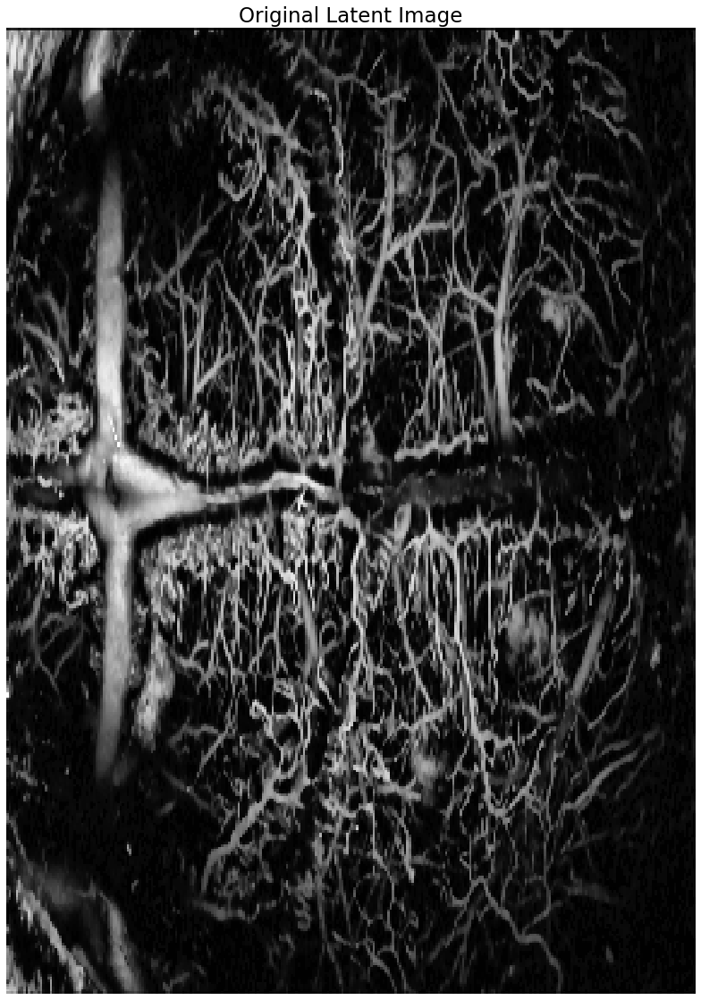

(1201, 2000)


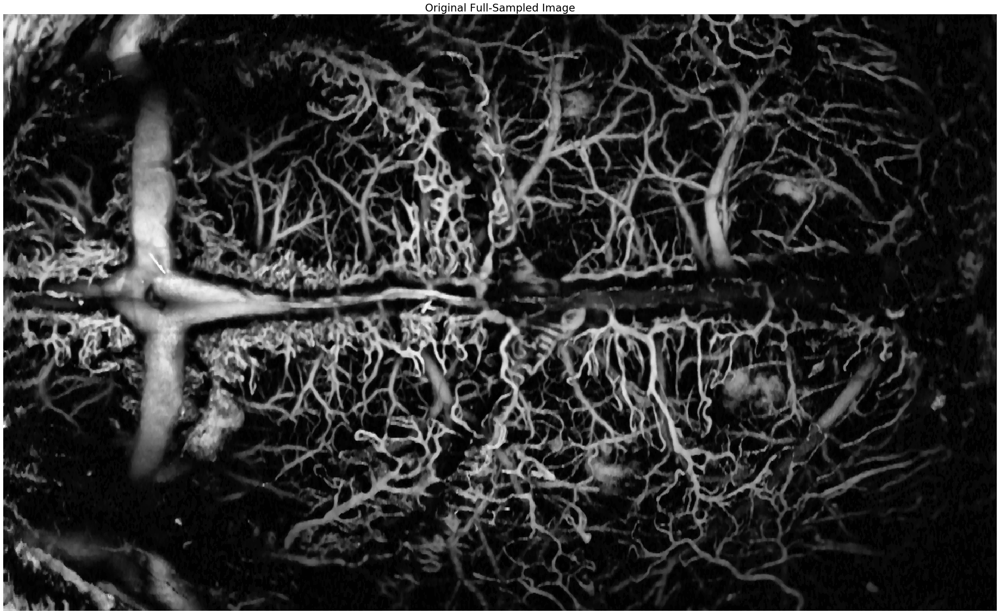

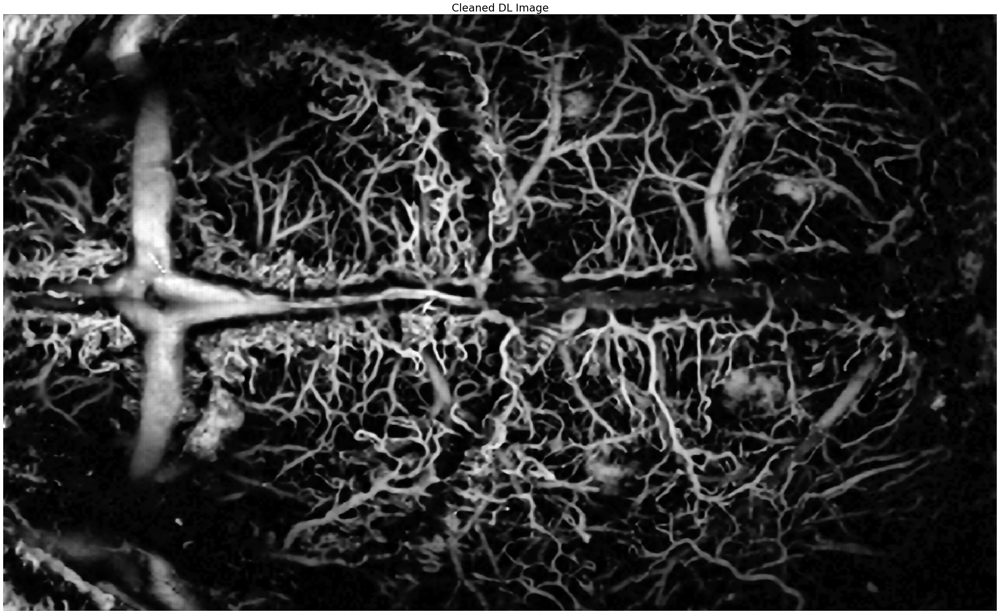

(1201, 2000)


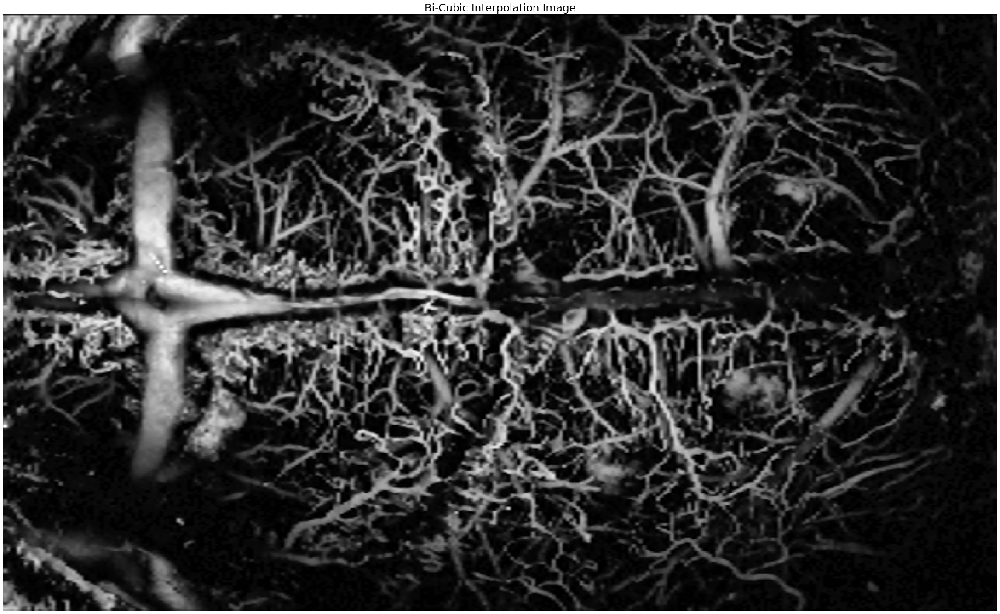

Saving to: figures_3i-7j_down


Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


In [8]:
dir_name = 'patchwork_test'
#saved_model = best_unet_model
#saved_model = unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,0], in_range='image', out_range=(0.0,1.0))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
# Resizing Images To Balance Downsampling Ratio Along Axes (one axis already downsampled in lab):
i_ratio = 2
j_ratio = 1
full_samp_img_shape = (full_samp_img.shape[0]*i_ratio, full_samp_img.shape[1]*j_ratio)
full_samp_img = skimage.transform.resize(full_samp_img, output_shape=full_samp_img_shape, order=3, 
                                         mode='reflect', cval=0, clip=True, preserve_range=True, 
                                         anti_aliasing=True, anti_aliasing_sigma=None)
full_samp_img_pad = full_samp_img

# Recover Latent Image (with pad):
downsampling_ratio = [3,7]
latent_image = np.zeros((int(np.ceil(full_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(full_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, full_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, full_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = full_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
latent_image_pad = latent_image

# Removing Image Border (if it exists)
full_samp_img = remove_padding(full_samp_img)

# Recover Latent Image (No Pad):
latent_image = np.zeros((int(np.ceil(full_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(full_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, full_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, full_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = full_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
print(latent_image.shape)
figsize = (15,15)
fontsize = 23
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image, cmap = 'gray')
plt.title('Original Latent Image', fontsize=fontsize)
plt.show()

print(full_samp_img.shape)
figsize = (30,30)
fontsize = 23
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Original Full-Sampled Image', fontsize=fontsize)
plt.show()
deep_image = apply_model_patchwork(saved_model, down_image = latent_image, downsampling_ratio = downsampling_ratio, 
                                   downsampling_axis = 'both', shape_for_model = (128,128), 
                                   buffer = 20, output_shape = full_samp_img.shape, interp=False)
deep_image = skimage.img_as_float(deep_image)
p1, p2 = np.percentile(deep_image, (0.01, 99.99))
deep_image = exposure.rescale_intensity(deep_image, in_range=(p1, p2), out_range=(0.0,1.0))
figsize = (30,30)
fontsize = 23
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Cleaned DL Image', fontsize=fontsize)
plt.show()

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
interp_img = skimage.transform.resize(latent_image, output_shape=full_samp_img.shape, 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, anti_aliasing=True, 
                                      anti_aliasing_sigma=None)
print(interp_img.shape)
figsize = (30,30)
fontsize = 23
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image', fontsize=fontsize)
plt.show()

# Saving Result Images:
directory = f'figures_{downsampling_ratio[0]}i-{downsampling_ratio[1]}j_down'
print(f'Saving to: {directory}')
if not os.path.exists(directory):
    os.mkdir(directory)
else:
    shutil.rmtree(directory)
    os.mkdir(directory)
filename = 'latent_image.png'
filepath = os.path.join(directory, filename)
latent_image = exposure.rescale_intensity(latent_image, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, deep_image, format='.png', compress_level=0)
filename = 'deep_image.png'
filepath = os.path.join(directory, filename)
deep_image = exposure.rescale_intensity(deep_image, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, deep_image, format='.png', compress_level=0)
filename = 'interp_img.png'
filepath = os.path.join(directory, filename)
interp_img = exposure.rescale_intensity(interp_img, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, interp_img, format='.png', compress_level=0)
filename = 'full_sample_img.png'
filepath = os.path.join(directory, filename)
full_samp_img = exposure.rescale_intensity(full_samp_img, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, full_samp_img, format='.png', compress_level=0)

In [9]:
# The crop indices were originally defined using the padded image dimensions
# This block ensures that there is no need to re-define the indicies

full_samp_img = full_samp_img_pad
latent_image = latent_image_pad

deep_image = apply_model_patchwork(saved_model, down_image = latent_image, downsampling_ratio = downsampling_ratio, 
                                   downsampling_axis = 'both', shape_for_model = (128,128), 
                                   buffer = 20, output_shape = full_samp_img.shape)
deep_image = skimage.img_as_float(deep_image)
p1, p2 = np.percentile(deep_image, (0.01, 99.99))
deep_image = exposure.rescale_intensity(deep_image, in_range=(p1, p2), out_range=(0.0,1.0))
interp_img = skimage.transform.resize(latent_image, output_shape=full_samp_img.shape, 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, 
                                      anti_aliasing=True, anti_aliasing_sigma=None)

filename = 'deep_image_pad.png'
filepath = os.path.join(directory, filename)
deep_image = exposure.rescale_intensity(deep_image, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, deep_image, format='.png', compress_level=0)
filename = 'interp_img_pad.png'
filepath = os.path.join(directory, filename)
interp_img = exposure.rescale_intensity(interp_img, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, interp_img, format='.png', compress_level=0)
filename = 'full_sample_img_pad.png'
filepath = os.path.join(directory, filename)
full_samp_img = exposure.rescale_intensity(full_samp_img, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, full_samp_img, format='.png', compress_level=0)

down_image = full_samp_img.copy()
for i in range(0, full_samp_img.shape[0]):
    for j in range(0, full_samp_img.shape[1]):
        if i%downsampling_ratio[0] != 0 or j%downsampling_ratio[1] != 0:
            down_image[i, j] = 0

### Showing and Saving Cropped Image Results

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


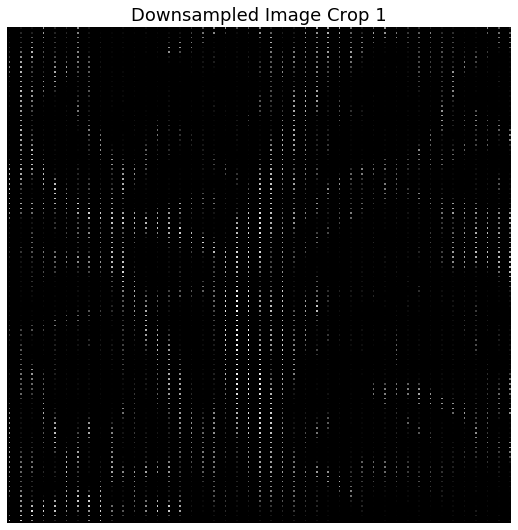

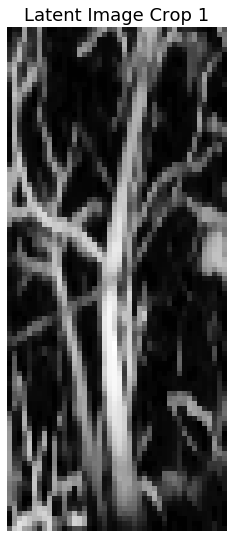

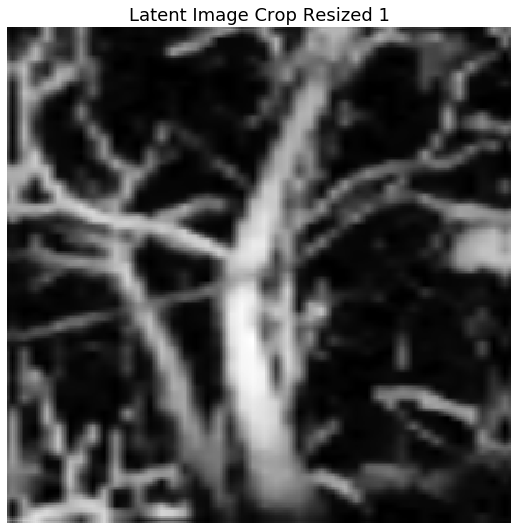

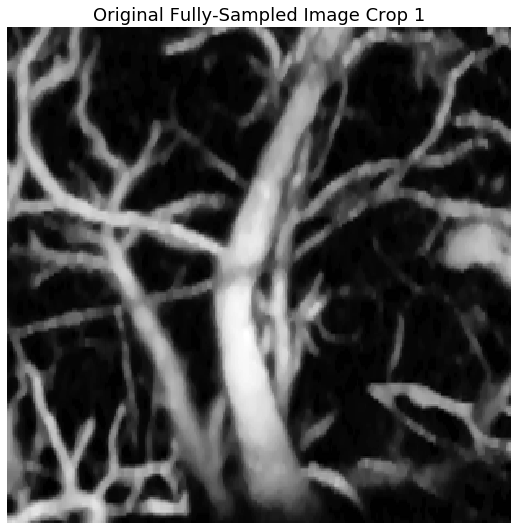

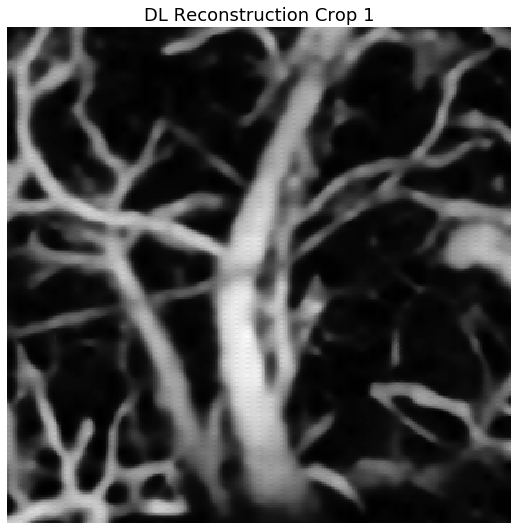

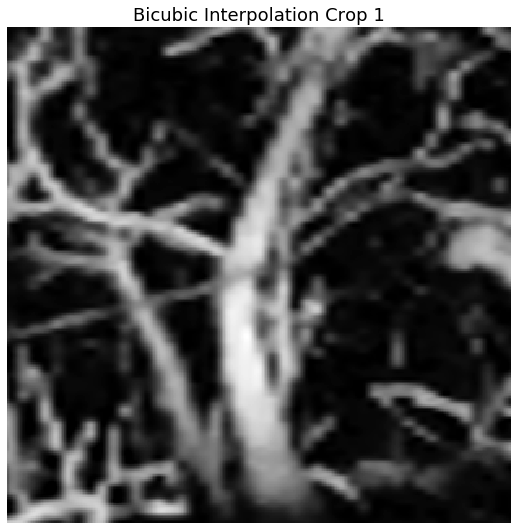

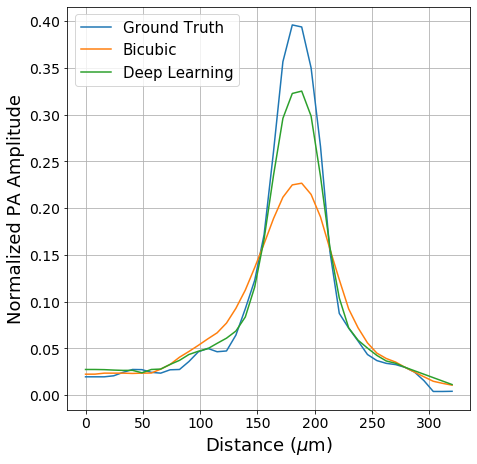

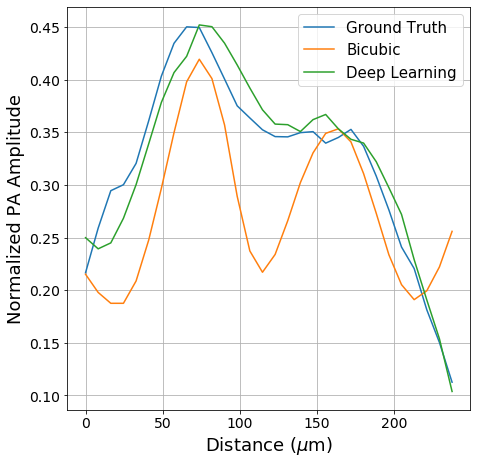

In [10]:
# Saving Result Images:

'''
IMAGE 1:
'''
ratio_0 = 1025/1280
ratio_1 = 720/1280
ratio_2 = 740/2048
ratio_3 = 430/2048

filename = 'down_image_crop_1.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
down_image_crop = down_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, down_image_crop, format='.png', compress_level=0)
filename = 'deep_image_crop_1.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
deep_image_crop = deep_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, deep_image_crop, format='.png', compress_level=0)
filename = 'interp_img_crop_1.png'
filepath = os.path.join(directory, filename)
interp_img_crop = interp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, interp_img_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_1.png'
filepath = os.path.join(directory, filename)
latent_image_crop = latent_image[int(latent_shape[0]-(ratio_0*latent_shape[0])):int(latent_shape[0]-(ratio_1*latent_shape[0])),
                             int(latent_shape[1]-(ratio_2*latent_shape[1])):int(latent_shape[1]-(ratio_3*latent_shape[1]))]
imageio.imwrite(filepath, latent_image_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_resized_1.png'
filepath = os.path.join(directory, filename)
latent_image_crop_resized = skimage.transform.resize(latent_image_crop, output_shape=down_image_crop.shape, 
                                                     order=1, mode='reflect', cval=0, clip=True, preserve_range=True, 
                                                     anti_aliasing=True, anti_aliasing_sigma=None)
imageio.imwrite(filepath, latent_image_crop_resized, format='.png', compress_level=0)
filename = 'full_img_crop_1.png'
filepath = os.path.join(directory, filename)
full_samp_img_crop = full_samp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                                   int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, full_samp_img_crop, format='.png', compress_level=0)

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(down_image_crop, cmap = 'gray')
plt.title('Downsampled Image Crop 1', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image_crop, cmap = 'gray')
plt.title('Latent Image Crop 1', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image_crop_resized, cmap = 'gray')
plt.title('Latent Image Crop Resized 1', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img_crop, cmap = 'gray')
plt.title('Original Fully-Sampled Image Crop 1', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image_crop, cmap = 'gray')
plt.title('DL Reconstruction Crop 1', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 1', fontsize=fontsize)
plt.show()

'''
# USED TO FIND A POTENTIAL VESSEL PROFILE LOCATION:
####################################################
angle = -40
figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
interp_crop = interp_img_crop[:interp_img_crop.shape[0]//3, 
                              2*interp_img_crop.shape[1]//3:]
interp_crop = skimage.transform.rotate(interp_crop, angle)
interp_crop[67, :] = 0
ax.imshow(interp_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 1 - Zoom')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
dl_crop = deep_image_crop[:deep_image_crop.shape[0]//3, 
                          2*deep_image_crop.shape[1]//3:]
dl_crop = skimage.transform.rotate(dl_crop, angle)
ax.imshow(dl_crop, cmap = 'gray')
plt.title('Deep Learing Crop 1 - Zoom')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
full_crop = full_samp_img_crop[:full_samp_img_crop.shape[0]//3, 
                               2*full_samp_img_crop.shape[1]//3:]
full_crop = skimage.transform.rotate(full_crop, angle)
ax.imshow(full_crop, cmap = 'gray')
plt.title('Fully-Sampled Crop 1 - Zoom')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
angle = 20
ax.imshow(skimage.transform.rotate(interp_img_crop, angle), cmap = 'gray')
plt.title('Bicubic Interpolation Crop 1 - Rotate')
plt.show()
'''

# Showing Vessel Profiles

DISP_CONV_FACTOR = 8.2 # converts pixels to micron

angle = -20
interp_crop = interp_img_crop[:interp_img_crop.shape[0]//3, 
                              :interp_img_crop.shape[1]//3]
interp_crop = skimage.transform.rotate(interp_crop, angle)
dl_crop = deep_image_crop[:deep_image_crop.shape[0]//3, 
                          :deep_image_crop.shape[1]//3]
dl_crop = skimage.transform.rotate(dl_crop, angle)
full_crop = full_samp_img_crop[:full_samp_img_crop.shape[0]//3, 
                               :full_samp_img_crop.shape[1]//3]
full_crop = skimage.transform.rotate(full_crop, angle)

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0.14,0.14,0.8,0.8])
y_shape = full_crop.shape[0]
x_shape = full_crop.shape[1]
ax.plot(np.arange(0, 40, 1)*DISP_CONV_FACTOR, full_crop[55, 22:62], 
        np.arange(0, 40, 1)*DISP_CONV_FACTOR, interp_crop[55, 22:62],
        np.arange(0, 40, 1)*DISP_CONV_FACTOR, dl_crop[55, 22:62])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 1', fontsize=fontsize)
plt.xlabel('Distance ($\mu$m)', fontsize=fontsize)
plt.ylabel('Normalized PA Amplitude', fontsize=fontsize)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
filename = 'vessel_compare_1.png'
filepath = os.path.join(directory, filename)
plt.savefig(filepath, dpi=300)
plt.show()

angle = -40
interp_crop = interp_img_crop[:interp_img_crop.shape[0]//3, 
                              2*interp_img_crop.shape[1]//3:]
interp_crop = skimage.transform.rotate(interp_crop, angle)
dl_crop = deep_image_crop[:deep_image_crop.shape[0]//3, 
                          2*deep_image_crop.shape[1]//3:]
dl_crop = skimage.transform.rotate(dl_crop, angle)
full_crop = full_samp_img_crop[:full_samp_img_crop.shape[0]//3, 
                               2*full_samp_img_crop.shape[1]//3:]
full_crop = skimage.transform.rotate(full_crop, angle)
figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0.14,0.14,0.8,0.8])
y_shape = full_crop.shape[0]
x_shape = full_crop.shape[1]
ax.plot(np.arange(0, 30, 1)*DISP_CONV_FACTOR, full_crop[67, 22:52], 
        np.arange(0, 30, 1)*DISP_CONV_FACTOR, interp_crop[67, 22:52],
        np.arange(0, 30, 1)*DISP_CONV_FACTOR, dl_crop[67, 22:52])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 2', fontsize=fontsize)
plt.xlabel('Distance ($\mu$m)', fontsize=fontsize)
plt.ylabel('Normalized PA Amplitude', fontsize=fontsize)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
filename = 'vessel_compare_2.png'
filepath = os.path.join(directory, filename)
plt.savefig(filepath, dpi=300)
plt.show()

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


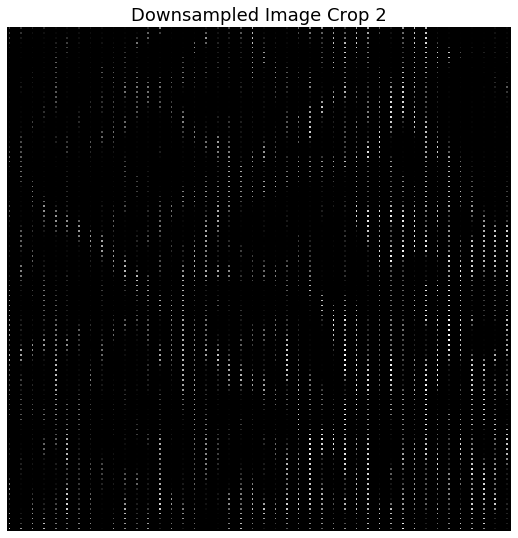

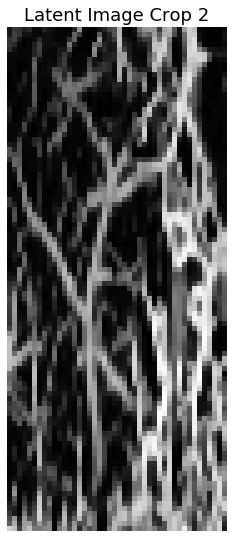

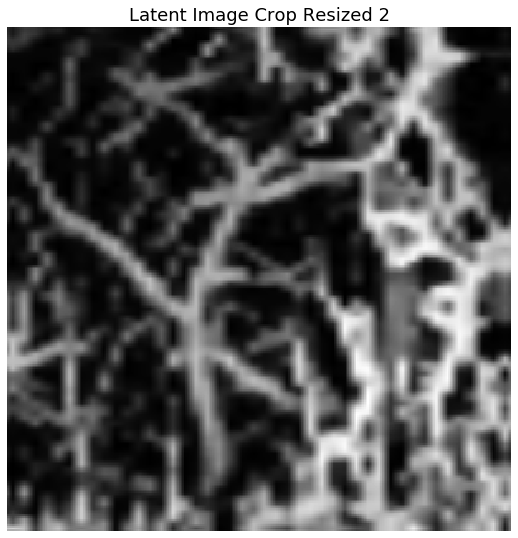

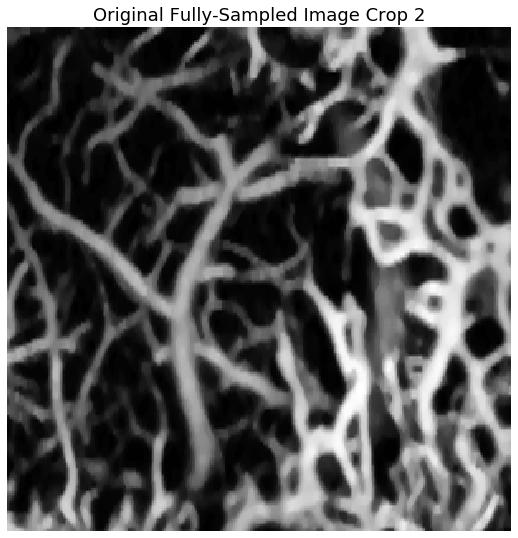

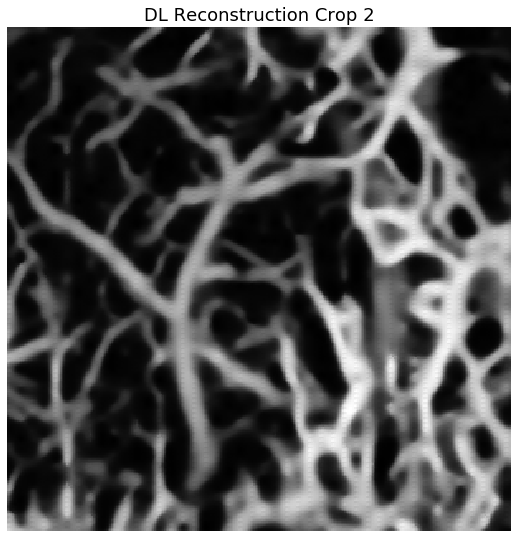

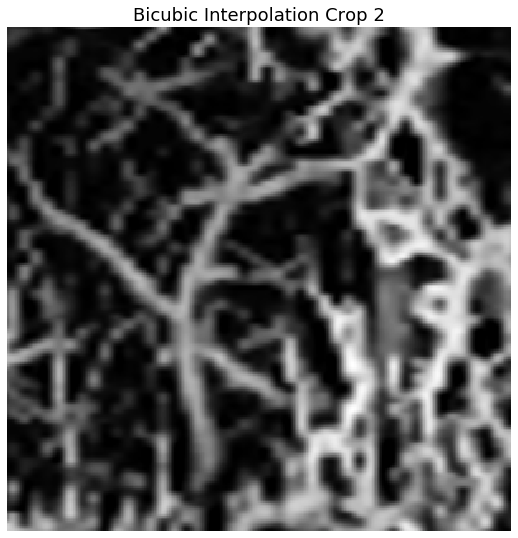

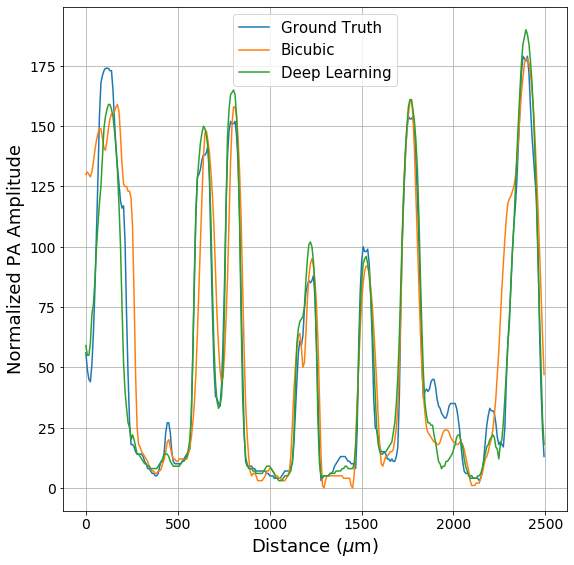

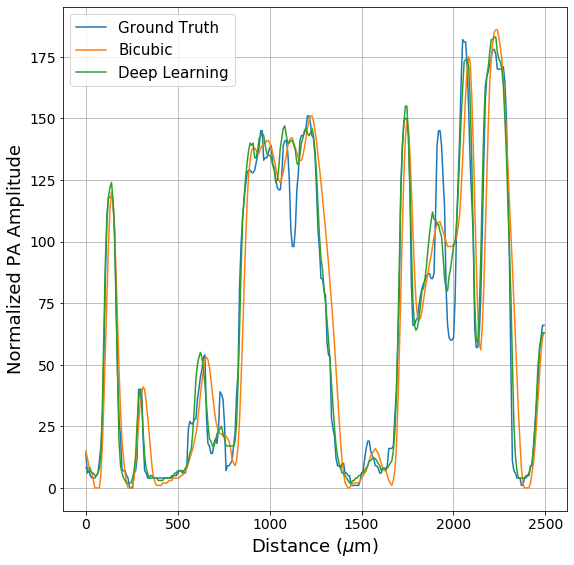

In [12]:
'''
IMAGE 2:
'''
ratio_0 = 1025/1280
ratio_1 = 720/1280
ratio_2 = 1405/2048
ratio_3 = 1100/2048

filename = 'down_image_crop_2.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
down_image_crop = down_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, down_image_crop, format='.png', compress_level=0)
filename = 'deep_image_crop_2.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
deep_image_crop = deep_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, deep_image_crop, format='.png', compress_level=0)
filename = 'interp_img_crop_2.png'
filepath = os.path.join(directory, filename)
interp_img_crop = interp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, interp_img_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_2.png'
filepath = os.path.join(directory, filename)
latent_image_crop = latent_image[int(latent_shape[0]-(ratio_0*latent_shape[0])):int(latent_shape[0]-(ratio_1*latent_shape[0])),
                             int(latent_shape[1]-(ratio_2*latent_shape[1])):int(latent_shape[1]-(ratio_3*latent_shape[1]))]
imageio.imwrite(filepath, latent_image_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_resized_2.png'
filepath = os.path.join(directory, filename)
latent_image_crop_resized = skimage.transform.resize(latent_image_crop, output_shape=down_image_crop.shape, 
                                                     order=1, mode='reflect', cval=0, clip=True, preserve_range=True, 
                                                     anti_aliasing=True, anti_aliasing_sigma=None)
imageio.imwrite(filepath, latent_image_crop_resized, format='.png', compress_level=0)
filename = 'full_img_crop_2.png'
filepath = os.path.join(directory, filename)
full_samp_img_crop = full_samp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                                   int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, full_samp_img_crop, format='.png', compress_level=0)

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(down_image_crop, cmap = 'gray')
plt.title('Downsampled Image Crop 2', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image_crop, cmap = 'gray')
plt.title('Latent Image Crop 2', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image_crop_resized, cmap = 'gray')
plt.title('Latent Image Crop Resized 2', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img_crop, cmap = 'gray')
plt.title('Original Fully-Sampled Image Crop 2', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image_crop, cmap = 'gray')
plt.title('DL Reconstruction Crop 2', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 2', fontsize=fontsize)
plt.show()

# Showing Vessel Profiles

DISP_CONV_FACTOR = 8.2 # converts pixels to micron

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[:, x_shape//2], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[:, x_shape//2],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[:, x_shape//2])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 3', fontsize=fontsize)
plt.xlabel('Distance ($\mu$m)', fontsize=fontsize)
plt.ylabel('Normalized PA Amplitude', fontsize=fontsize)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[y_shape//3, :], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[y_shape//3, :],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[y_shape//3, :])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 4', fontsize=fontsize)
plt.xlabel('Distance ($\mu$m)', fontsize=fontsize)
plt.ylabel('Normalized PA Amplitude', fontsize=fontsize)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


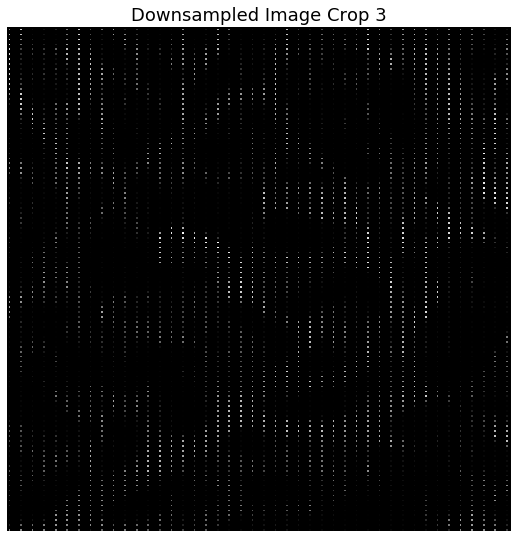

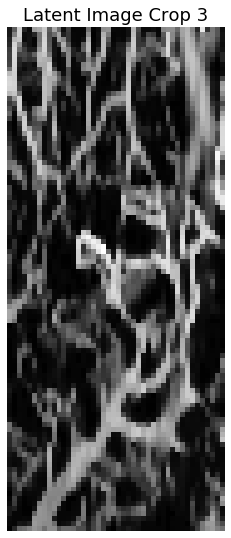

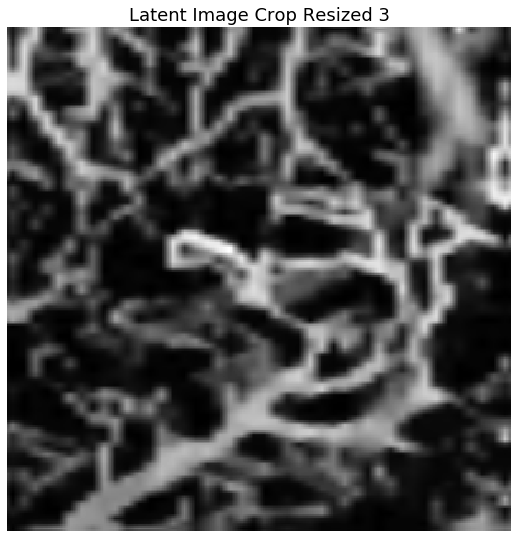

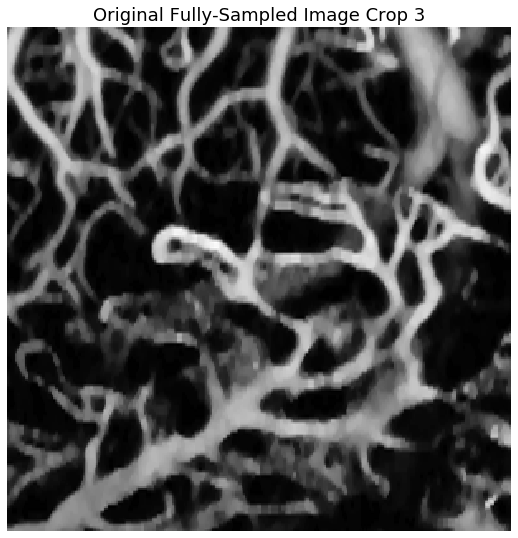

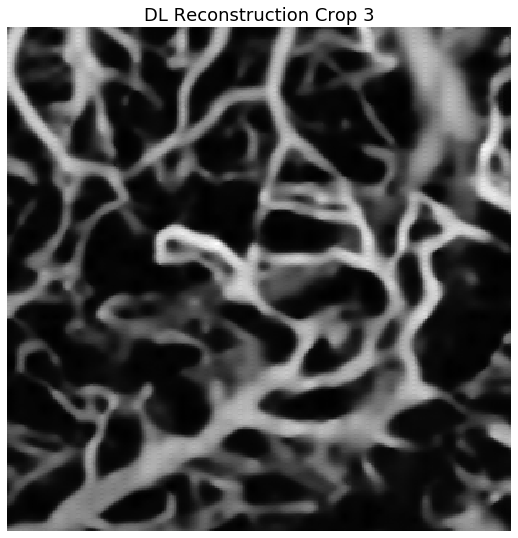

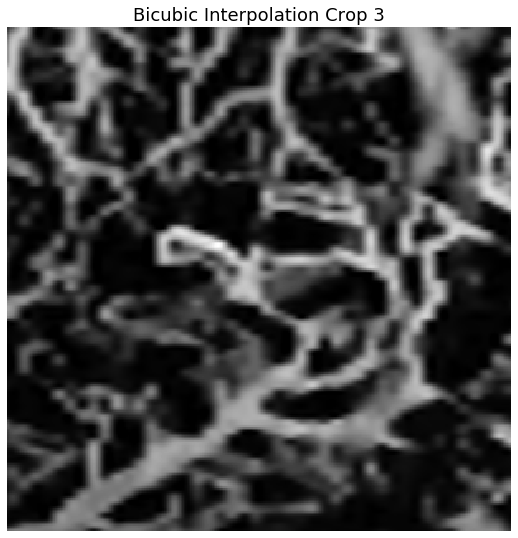

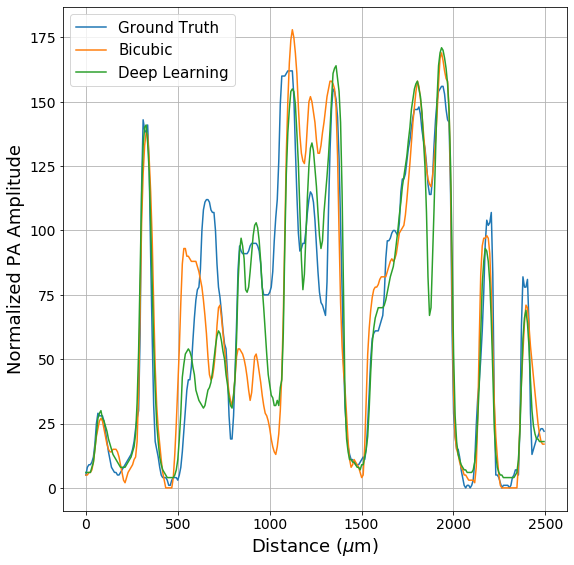

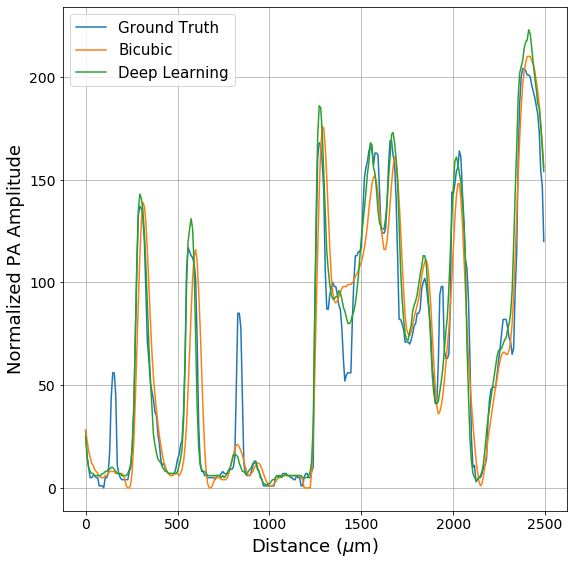

In [13]:
'''
IMAGE 3:
'''
ratio_0 = 525/1280
ratio_1 = 220/1280
ratio_2 = 1405/2048
ratio_3 = 1100/2048

filename = 'down_image_crop_3.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
down_image_crop = down_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, down_image_crop, format='.png', compress_level=0)
filename = 'deep_image_crop_3.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
deep_image_crop = deep_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, deep_image_crop, format='.png', compress_level=0)
filename = 'interp_img_crop_3.png'
filepath = os.path.join(directory, filename)
interp_img_crop = interp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, interp_img_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_3.png'
filepath = os.path.join(directory, filename)
latent_image_crop = latent_image[int(latent_shape[0]-(ratio_0*latent_shape[0])):int(latent_shape[0]-(ratio_1*latent_shape[0])),
                             int(latent_shape[1]-(ratio_2*latent_shape[1])):int(latent_shape[1]-(ratio_3*latent_shape[1]))]
imageio.imwrite(filepath, latent_image_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_resized_3.png'
filepath = os.path.join(directory, filename)
latent_image_crop_resized = skimage.transform.resize(latent_image_crop, output_shape=down_image_crop.shape, 
                                                     order=1, mode='reflect', cval=0, clip=True, preserve_range=True, 
                                                     anti_aliasing=True, anti_aliasing_sigma=None)
imageio.imwrite(filepath, latent_image_crop_resized, format='.png', compress_level=0)
filename = 'full_img_crop_3.png'
filepath = os.path.join(directory, filename)
full_samp_img_crop = full_samp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                                   int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, full_samp_img_crop, format='.png', compress_level=0)

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(down_image_crop, cmap = 'gray')
plt.title('Downsampled Image Crop 3', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image_crop, cmap = 'gray')
plt.title('Latent Image Crop 3', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image_crop_resized, cmap = 'gray')
plt.title('Latent Image Crop Resized 3', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img_crop, cmap = 'gray')
plt.title('Original Fully-Sampled Image Crop 3', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image_crop, cmap = 'gray')
plt.title('DL Reconstruction Crop 3', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 3', fontsize=fontsize)
plt.show()

# Showing Vessel Profiles

DISP_CONV_FACTOR = 8.2 # converts pixels to micron

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[:, x_shape//2], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[:, x_shape//2],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[:, x_shape//2])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 5', fontsize=fontsize)
plt.xlabel('Distance ($\mu$m)', fontsize=fontsize)
plt.ylabel('Normalized PA Amplitude', fontsize=fontsize)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[y_shape//3, :], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[y_shape//3, :],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[y_shape//3, :])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 6', fontsize=fontsize)
plt.xlabel('Distance ($\mu$m)', fontsize=fontsize)
plt.ylabel('Normalized PA Amplitude', fontsize=fontsize)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.
Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


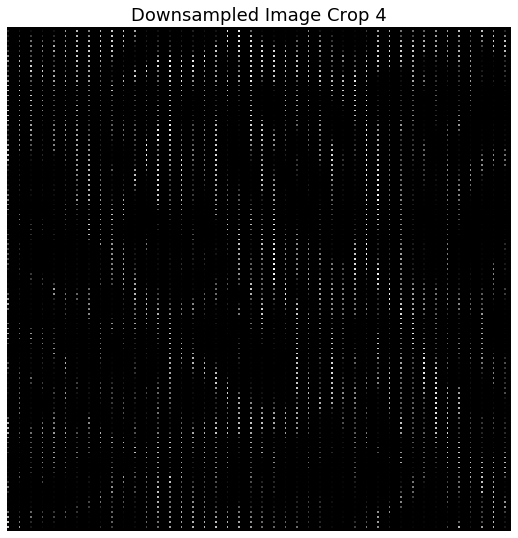

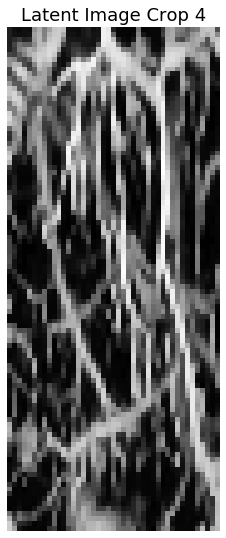

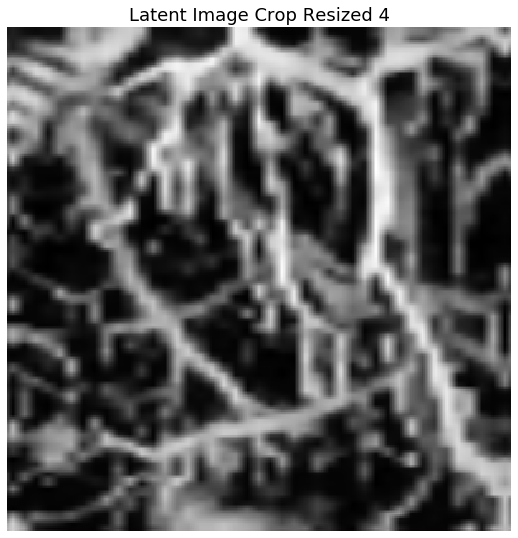

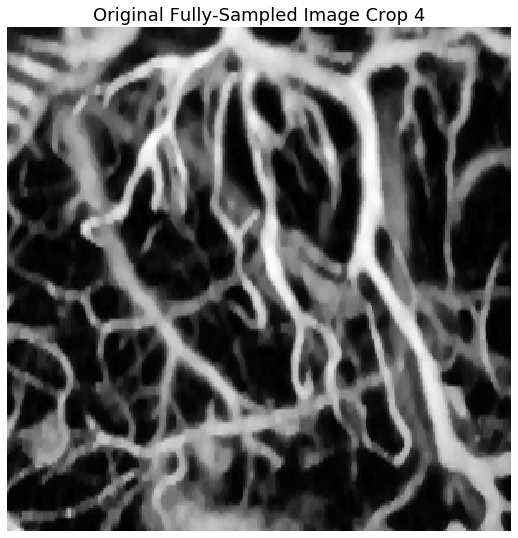

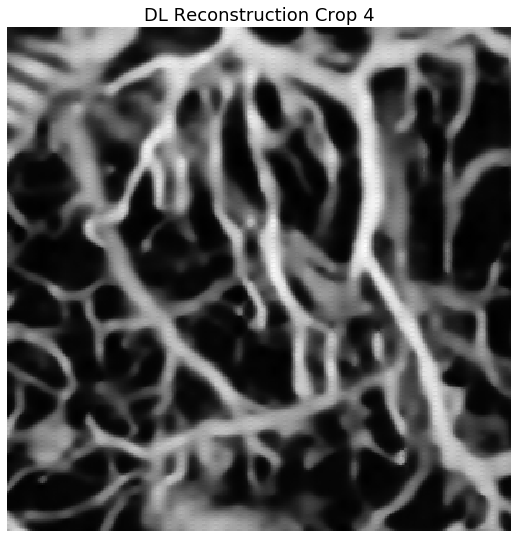

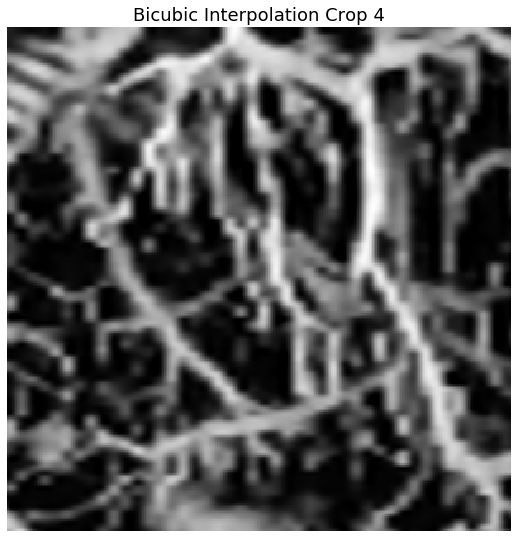

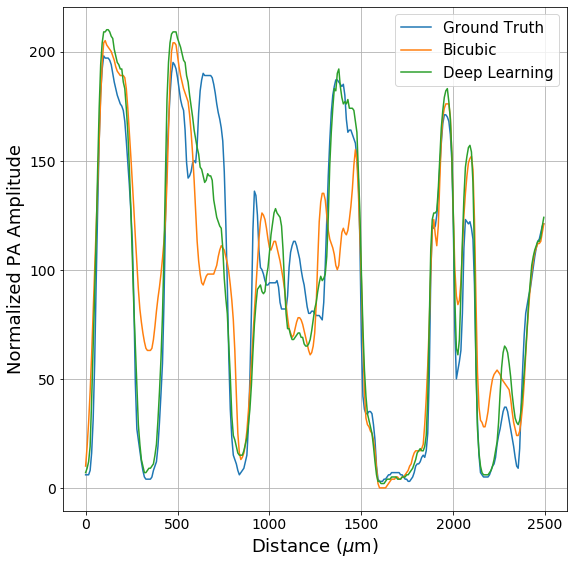

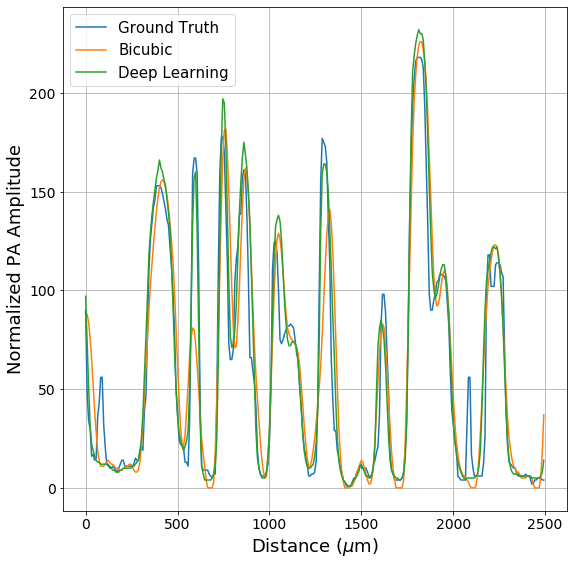

In [14]:
'''
IMAGE 4:
'''
ratio_0 = 625/1280
ratio_1 = 320/1280
ratio_2 = 935/2048
ratio_3 = 630/2048

filename = 'down_image_crop_4.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
down_image_crop = down_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, down_image_crop, format='.png', compress_level=0)
filename = 'deep_image_crop_4.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
deep_image_crop = deep_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, deep_image_crop, format='.png', compress_level=0)
filename = 'interp_img_crop_4.png'
filepath = os.path.join(directory, filename)
interp_img_crop = interp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, interp_img_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_4.png'
filepath = os.path.join(directory, filename)
latent_image_crop = latent_image[int(latent_shape[0]-(ratio_0*latent_shape[0])):int(latent_shape[0]-(ratio_1*latent_shape[0])),
                             int(latent_shape[1]-(ratio_2*latent_shape[1])):int(latent_shape[1]-(ratio_3*latent_shape[1]))]
imageio.imwrite(filepath, latent_image_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_resized_4.png'
filepath = os.path.join(directory, filename)
latent_image_crop_resized = skimage.transform.resize(latent_image_crop, output_shape=down_image_crop.shape, 
                                                     order=1, mode='reflect', cval=0, clip=True, preserve_range=True, 
                                                     anti_aliasing=True, anti_aliasing_sigma=None)
imageio.imwrite(filepath, latent_image_crop_resized, format='.png', compress_level=0)
filename = 'full_img_crop_4.png'
filepath = os.path.join(directory, filename)
full_samp_img_crop = full_samp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                                   int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, full_samp_img_crop, format='.png', compress_level=0)

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(down_image_crop, cmap = 'gray')
plt.title('Downsampled Image Crop 4', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image_crop, cmap = 'gray')
plt.title('Latent Image Crop 4', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image_crop_resized, cmap = 'gray')
plt.title('Latent Image Crop Resized 4', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img_crop, cmap = 'gray')
plt.title('Original Fully-Sampled Image Crop 4', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image_crop, cmap = 'gray')
plt.title('DL Reconstruction Crop 4', fontsize=fontsize)
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 4', fontsize=fontsize)
plt.show()

# Showing Vessel Profiles

DISP_CONV_FACTOR = 8.2 # converts pixels to micron

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[:, x_shape//2], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[:, x_shape//2],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[:, x_shape//2])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 7, fontsize=fontsize')
plt.xlabel('Distance ($\mu$m)', fontsize=18)
plt.ylabel('Normalized PA Amplitude', fontsize=18)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

figsize = (7,7)
fontsize = 18
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[y_shape//3, :], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[y_shape//3, :],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[y_shape//3, :])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 8, fontsize=fontsize')
plt.xlabel('Distance ($\mu$m)', fontsize=fontsize)
plt.ylabel('Normalized PA Amplitude', fontsize=fontsize)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

# Creating Training Data where Downsampling is Performed and then using Various Pre-Reconstruction Methods

### Extracting Fully Sampled Data from Previous "Data" Folder to Create Folders With Different Downsampling Ratios While Maintaining the Same Data Split

In [23]:
def extract_full_samp_and_retain_file_struct(input_dir, output_dir, delete_previous = True):
    '''
    This function loops through an input directory and converts each file to undo the
    function "pad_img_and_add_down_channel." The modified image is then saved into the 
    output directory.
    '''
    print('Starting Extraction...')
    abs_input_dir = os.path.join(os.getcwd(), input_dir)
    folder_list = os.listdir(abs_input_dir)
    abs_output_dir = os.path.join(os.getcwd(), output_dir)
    if not os.path.exists(abs_output_dir):
        os.mkdir(abs_output_dir)
    elif delete_previous == True:
        shutil.rmtree(abs_output_dir)
        os.mkdir(abs_output_dir)
    for folder in folder_list:
        if folder != '.ipynb_checkpoints':
            folder_dir = os.path.join(abs_input_dir, folder)
            folder_dir = os.path.join(folder_dir, 'input')
            file_list = os.listdir(folder_dir)
            new_dir = os.path.join(abs_output_dir, folder)
            if not os.path.exists(new_dir):
                os.mkdir(new_dir)
                new_dir = os.path.join(new_dir, 'input')
                os.mkdir(new_dir)
            for file in file_list:
                filename = os.fsdecode(file)
                filepath = os.path.join(folder_dir, filename)
                if filepath.endswith('.npy'):
                    array = np.load(filepath)
                else:
                    array = imageio.imread(filepath)
                if len(array.shape) == 3:
                    array = array[..., 0] # First Index Represents Fully Sampled Image
                else: 
                    print('Error: please only input data directory that has already been formatted using function \"standardize_dir\"')
                new_filepath = os.path.join(new_dir, filename)
                if filepath.endswith('.npy'):
                    new_filepath = Path(new_filepath)
                    np.save(new_filepath, array, allow_pickle=True, fix_imports=True)
                else:
                    new_filepath = Path(new_filepath)
                    imageio.imwrite(new_filepath, array)
    print('Ending Extraction !!!')

In [24]:
input_dir = 'data'
output_dir = 'data_1'
extract_full_samp_and_retain_file_struct(input_dir, output_dir, delete_previous = True)

Starting Extraction...
Ending Extraction !!!


### BICUBIC INTERPOLATION METHOD - Going Through Directory to Downsample and then Partially Reconstructing Using Interpolation

In [35]:
# Import Statements:
import standardize_dir_utils
from standardize_dir_utils import pad_img_and_add_interp_down_channel
from standardize_dir_utils import standardize_dir

In [36]:
STANDARD_IMAGE_SHAPE = (128,128,1)
DOWN_RATIO = [3,7]
INTERPOLATION = True

In [37]:
INPUT_DIR = 'data_1/train/input'
total_train_image_pool = standardize_dir(input_dir = INPUT_DIR, downsample_axis = 'both', downsample_ratio = DOWN_RATIO, 
                                         standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_down_ratio = True,
                                         interp = INTERPOLATION)
print('total_train_image_pool = ' + str(total_train_image_pool))

total_train_image_pool = 235


In [38]:
INPUT_DIR = 'data_1/val/input'
total_val_image_pool = standardize_dir(input_dir = INPUT_DIR, downsample_axis = 'both', downsample_ratio = DOWN_RATIO, 
                                       standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_down_ratio = True,
                                       interp = INTERPOLATION)
print('total_val_image_pool = ' + str(total_val_image_pool))

total_val_image_pool = 30


In [39]:
INPUT_DIR = 'data_1/test/input'
total_test_image_pool = standardize_dir(input_dir = INPUT_DIR, downsample_axis = 'both', downsample_ratio = DOWN_RATIO, 
                                        standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_down_ratio = True,
                                        interp = INTERPOLATION)
print('total_test_image_pool = ' + str(total_test_image_pool))

total_test_image_pool = 29


### ZERO FILL METHOD - Going Through Directory to Downsample and Fill in Missing Pixels with Zero Fill

In [25]:
# Import Statements:
import standardize_dir_utils
from standardize_dir_utils import pad_img_and_add_down_channel
from standardize_dir_utils import standardize_dir

In [26]:
STANDARD_IMAGE_SHAPE = (128,128,1)
DOWN_RATIO = [1,5]
main_dir = 'data_1'

In [27]:
INPUT_DIR = main_dir + '/train/input'
total_train_image_pool = standardize_dir(input_dir = INPUT_DIR, downsample_axis = 'both', downsample_ratio = DOWN_RATIO, 
                                         standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_down_ratio = True)
print('total_train_image_pool = ' + str(total_train_image_pool))

total_train_image_pool = 233


In [28]:
INPUT_DIR = main_dir + '/val/input'
total_val_image_pool = standardize_dir(input_dir = INPUT_DIR, downsample_axis = 'both', downsample_ratio = DOWN_RATIO, 
                                       standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_down_ratio = True)
print('total_val_image_pool = ' + str(total_val_image_pool))

total_val_image_pool = 30


In [29]:
INPUT_DIR = main_dir + '/test/input'
total_test_image_pool = standardize_dir(input_dir = INPUT_DIR, downsample_axis = 'both', downsample_ratio = DOWN_RATIO, 
                                        standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_down_ratio = True)
print('total_test_image_pool = ' + str(total_test_image_pool))

total_test_image_pool = 29


### ZERO FILL (WITH BLUR) METHOD - Going Through Directory to Downsample, Filling in Missing Pixels with Zero Fill, and then applying Gaussian blur

In [39]:
# Import Statements:
import standardize_dir_utils
from standardize_dir_utils import pad_img_and_add_down_channel
from standardize_dir_utils import standardize_dir

In [40]:
STANDARD_IMAGE_SHAPE = (128,128,1)
DOWN_RATIO = [3,7]
BLUR = 2.0

In [41]:
INPUT_DIR = 'data_1/train/input'
total_train_image_pool = standardize_dir(input_dir = INPUT_DIR, downsample_axis = 'both', downsample_ratio = DOWN_RATIO, 
                                         standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_down_ratio = True, gauss_blur_std=BLUR)
print('total_train_image_pool = ' + str(total_train_image_pool))

total_train_image_pool = 235


In [42]:
INPUT_DIR = 'data_1/val/input'
total_val_image_pool = standardize_dir(input_dir = INPUT_DIR, downsample_axis = 'both', downsample_ratio = DOWN_RATIO, 
                                       standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_down_ratio = True, gauss_blur_std=BLUR)
print('total_val_image_pool = ' + str(total_val_image_pool))

total_val_image_pool = 30


In [43]:
INPUT_DIR = 'data_1/test/input'
total_test_image_pool = standardize_dir(input_dir = INPUT_DIR, downsample_axis = 'both', downsample_ratio = DOWN_RATIO, 
                                        standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_down_ratio = True, gauss_blur_std=BLUR)
print('total_test_image_pool = ' + str(total_test_image_pool))

total_test_image_pool = 29


# Creating Test Images for Interpolation Pre-Reconstruction Results

## Load Model

In [98]:
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
print('Loading Model...')
input_dir = 'saved_model_FD_UNet_3i-7j_down\\best_models'
filename = sorted(os.listdir(input_dir), key = lambda x : int(x.partition('h_')[2].partition('-S')[0]))[-1]
directory = os.path.join(os.getcwd(), input_dir)
directory = os.path.join(directory, filename)
saved_model = tf.keras.models.load_model(directory, custom_objects={'model_loss':model_loss,'loss_func':model_loss(B1=0.99,B2=0.01), 
                                                                    'PSNR':PSNR, 'SSIM':SSIM, 'KLDivergence':KLDivergence, 
                                                                    'SavingMetric':SavingMetric})
print('Done Loading Best Model (' + filename + ') from: ' + input_dir)

Loading Model...
Done Loading Best Model (saved_model.epoch_358-SSIM_0.85769-PSNR_27.74997-metric_0.17856.h5) from: saved_model_FD_UNet_3i-7j_down_v2\best_models


In [9]:
# Import Statements:
import patchwork_alg
from patchwork_alg import expand_image_with_interp
from patchwork_alg import apply_model_patchwork
from patchwork_alg import remove_peak
from patchwork_alg import remove_padding

### Showing and Saving Full Image Results

Directory: patchwork_test\reslt_OR_9 (5)_index0_pad.tif
(401, 286)


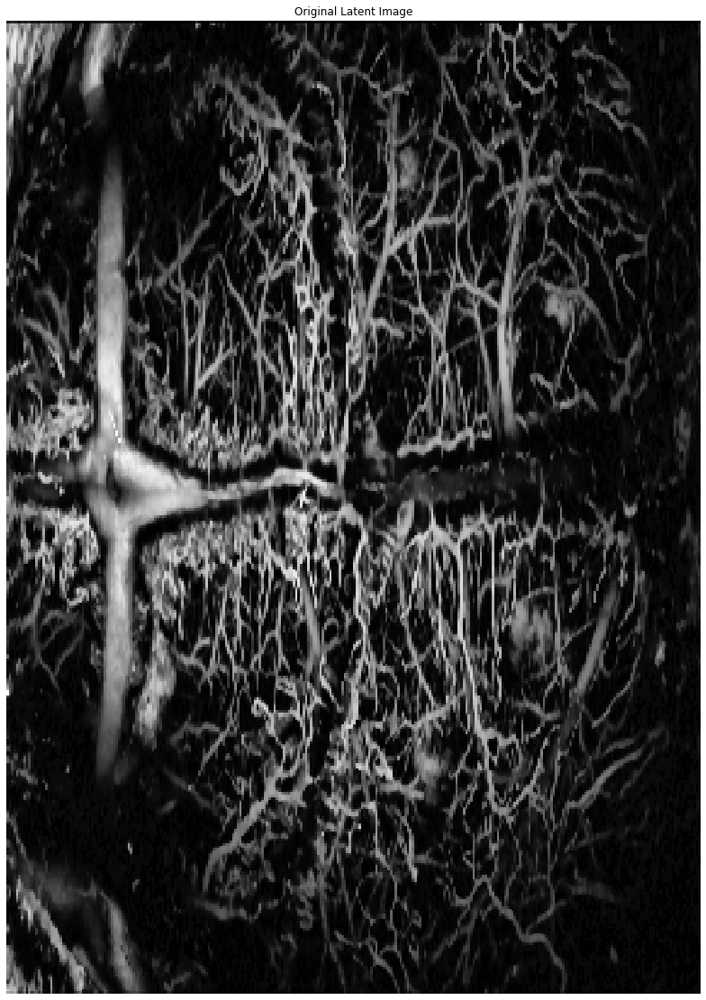

(1201, 2000)


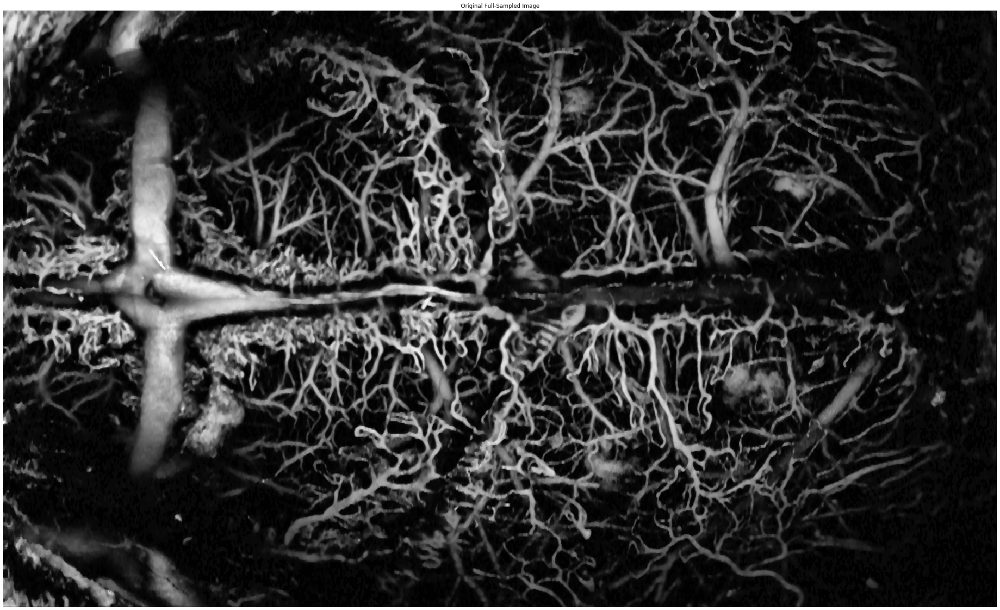

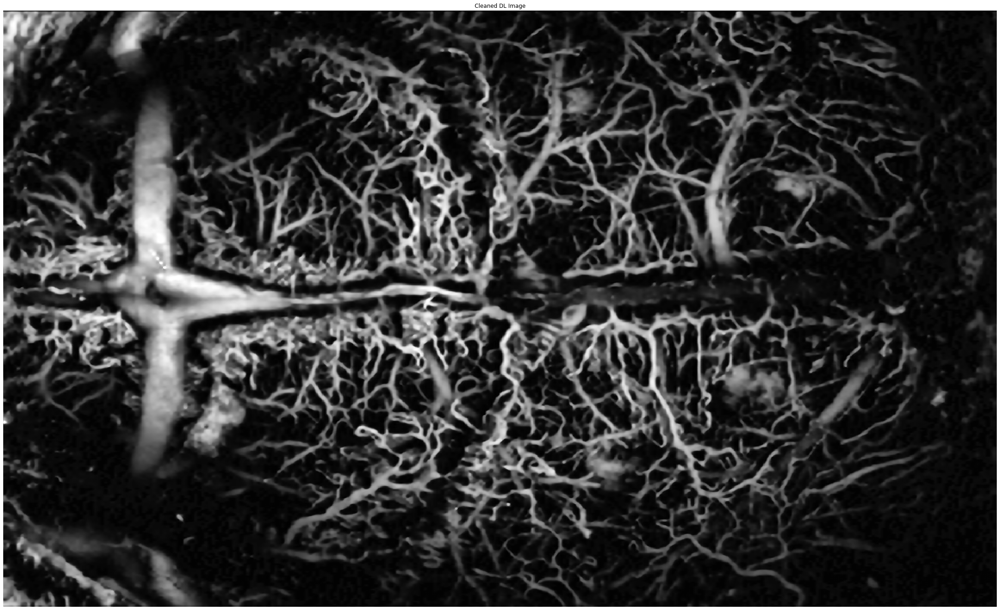

(1201, 2000)


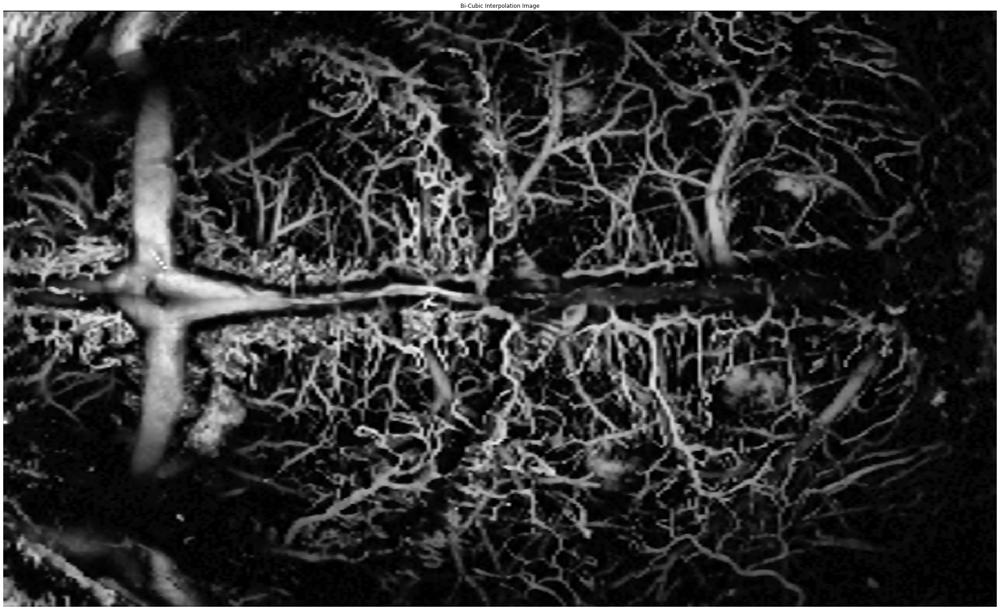

In [10]:
dir_name = 'patchwork_test'
#saved_model = best_unet_model
#saved_model = unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,0], in_range='image', out_range=(0.0,1.0))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
# Resizing Images To Balance Downsampling Ratio Along Axes (one axis already downsampled in lab):
i_ratio = 2
j_ratio = 1
full_samp_img_shape = (full_samp_img.shape[0]*i_ratio, full_samp_img.shape[1]*j_ratio)
full_samp_img = skimage.transform.resize(full_samp_img, output_shape=full_samp_img_shape, order=3, 
                                         mode='reflect', cval=0, clip=True, preserve_range=True, 
                                         anti_aliasing=True, anti_aliasing_sigma=None)
full_samp_img_pad = full_samp_img

# Recover Latent Image (with pad):
downsampling_ratio = [3,7]
latent_image = np.zeros((int(np.ceil(full_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(full_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, full_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, full_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = full_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
latent_image_pad = latent_image

# Removing Image Border (if it exists)
full_samp_img = remove_padding(full_samp_img)

# Recover Latent Image (No Pad):
latent_image = np.zeros((int(np.ceil(full_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(full_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, full_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, full_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = full_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
print(latent_image.shape)
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image, cmap = 'gray')
plt.title('Original Latent Image')
plt.show()

print(full_samp_img.shape)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Original Full-Sampled Image')
plt.show()
deep_image = apply_model_patchwork(saved_model, down_image = latent_image, downsampling_ratio = downsampling_ratio, 
                                   downsampling_axis = 'both', shape_for_model = (128,128), 
                                   buffer = 20, output_shape = full_samp_img.shape, interp=True)
deep_image = skimage.img_as_float(deep_image)
p1, p2 = np.percentile(deep_image, (0.01, 99.99))
deep_image = exposure.rescale_intensity(deep_image, in_range=(p1, p2), out_range=(0.0,1.0))
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Cleaned DL Image')
plt.show()

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
interp_img = skimage.transform.resize(latent_image, output_shape=full_samp_img.shape, 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, anti_aliasing=True, 
                                      anti_aliasing_sigma=None)
print(interp_img.shape)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image')
plt.show()

# Saving Result Images:
directory = f'figures_{downsampling_ratio[0]}i-{downsampling_ratio[1]}j_down'
print(f'Saving to: {directory}')
if not os.path.exists(directory):
    os.mkdir(directory)
else:
    shutil.rmtree(directory)
    os.mkdir(directory)
filename = 'deep_image.png'
filepath = os.path.join(directory, filename)
deep_image = exposure.rescale_intensity(deep_image, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, deep_image, format='.png', compress_level=0)
filename = 'interp_img.png'
filepath = os.path.join(directory, filename)
interp_img = exposure.rescale_intensity(interp_img, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, interp_img, format='.png', compress_level=0)
filename = 'full_sample_img.png'
filepath = os.path.join(directory, filename)
full_samp_img = exposure.rescale_intensity(full_samp_img, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, full_samp_img, format='.png', compress_level=0)

In [19]:
full_samp_img = full_samp_img_pad
latent_image = latent_image_pad

deep_image = apply_model_patchwork_with_interp(saved_model, down_image = latent_image, downsampling_ratio = downsampling_ratio, 
                                               downsampling_axis = 'both', shape_for_model = (128,128), 
                                               buffer = 20, output_shape = full_samp_img.shape)
deep_image = skimage.img_as_float(deep_image)
p1, p2 = np.percentile(deep_image, (0.01, 99.99))
deep_image = exposure.rescale_intensity(deep_image, in_range=(p1, p2), out_range=(0.0,1.0))
interp_img = skimage.transform.resize(latent_image, output_shape=full_samp_img.shape, 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, 
                                      anti_aliasing=True, anti_aliasing_sigma=None)

filename = 'deep_image_pad.png'
filepath = os.path.join(directory, filename)
deep_image = exposure.rescale_intensity(deep_image, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, deep_image, format='.png', compress_level=0)
filename = 'interp_img_pad.png'
filepath = os.path.join(directory, filename)
interp_img = exposure.rescale_intensity(interp_img, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, interp_img, format='.png', compress_level=0)
filename = 'full_sample_img_pad.png'
filepath = os.path.join(directory, filename)
full_samp_img = exposure.rescale_intensity(full_samp_img, in_range='image', out_range=(0,255)).astype(np.uint8)
imageio.imwrite(filepath, full_samp_img, format='.png', compress_level=0)

### Showing and Saving Cropped Image Results

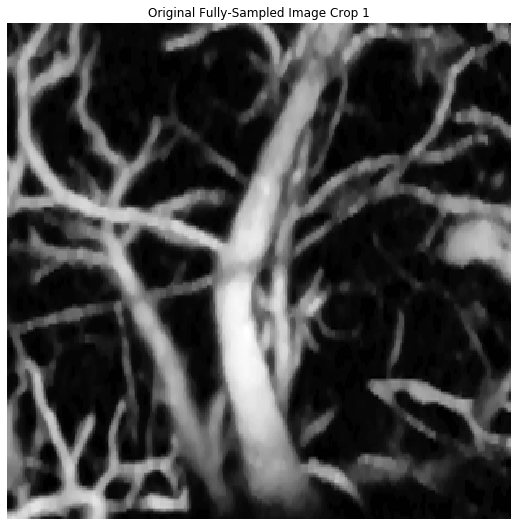

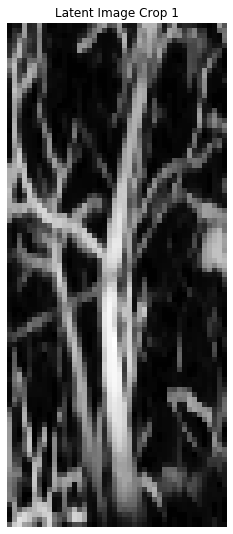

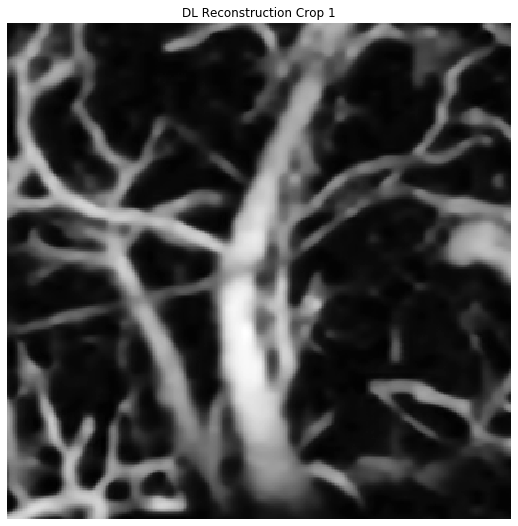

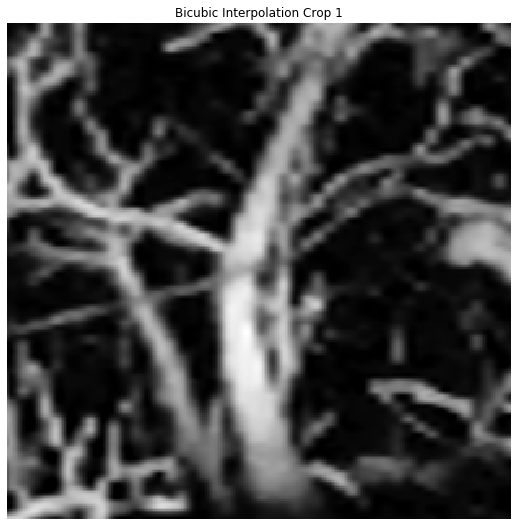

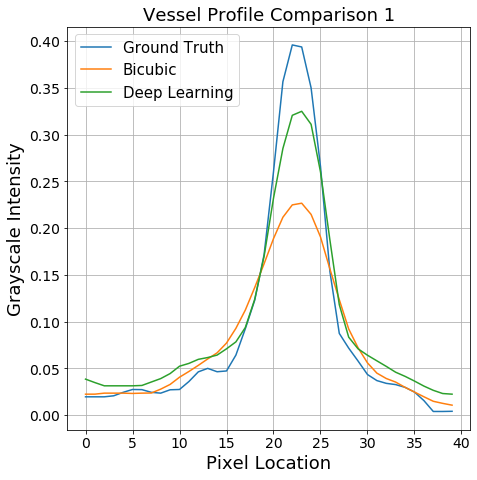

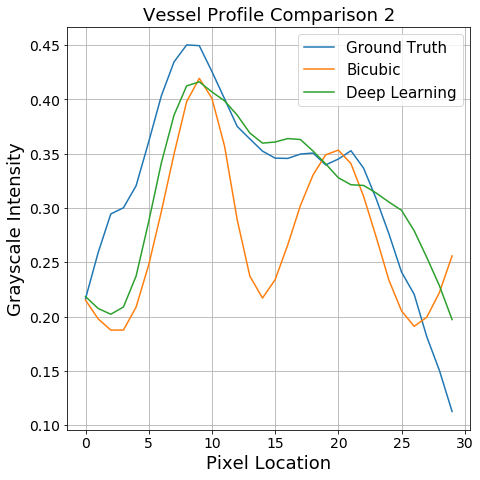

In [36]:
# Saving Result Images:

'''
IMAGE 1:
'''
ratio_0 = 1025/1280
ratio_1 = 720/1280
ratio_2 = 740/2048
ratio_3 = 430/2048

filename = 'deep_image_crop_1.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
deep_image_crop = deep_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, deep_image_crop, format='.png', compress_level=0)
filename = 'interp_img_crop_1.png'
filepath = os.path.join(directory, filename)
interp_img_crop = interp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, interp_img_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_1.png'
filepath = os.path.join(directory, filename)
latent_image_crop = latent_image[int(latent_shape[0]-(ratio_0*latent_shape[0])):int(latent_shape[0]-(ratio_1*latent_shape[0])),
                             int(latent_shape[1]-(ratio_2*latent_shape[1])):int(latent_shape[1]-(ratio_3*latent_shape[1]))]
imageio.imwrite(filepath, latent_image_crop, format='.png', compress_level=0)
filename = 'full_img_crop_1.png'
filepath = os.path.join(directory, filename)
full_samp_img_crop = full_samp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                                   int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, full_samp_img_crop, format='.png', compress_level=0)

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img_crop, cmap = 'gray')
plt.title('Original Fully-Sampled Image Crop 1')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image_crop, cmap = 'gray')
plt.title('Latent Image Crop 1')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image_crop, cmap = 'gray')
plt.title('DL Reconstruction Crop 1')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 1')
plt.show()

'''
# USED TO FIND A POTENTIAL VESSEL PROFILE LOCATION:
####################################################
angle = -40
figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
interp_crop = interp_img_crop[:interp_img_crop.shape[0]//3, 
                              2*interp_img_crop.shape[1]//3:]
interp_crop = skimage.transform.rotate(interp_crop, angle)
interp_crop[67, :] = 0
ax.imshow(interp_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 1 - Zoom')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
dl_crop = deep_image_crop[:deep_image_crop.shape[0]//3, 
                          2*deep_image_crop.shape[1]//3:]
dl_crop = skimage.transform.rotate(dl_crop, angle)
ax.imshow(dl_crop, cmap = 'gray')
plt.title('Deep Learing Crop 1 - Zoom')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
full_crop = full_samp_img_crop[:full_samp_img_crop.shape[0]//3, 
                               2*full_samp_img_crop.shape[1]//3:]
full_crop = skimage.transform.rotate(full_crop, angle)
ax.imshow(full_crop, cmap = 'gray')
plt.title('Fully-Sampled Crop 1 - Zoom')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
angle = 20
ax.imshow(skimage.transform.rotate(interp_img_crop, angle), cmap = 'gray')
plt.title('Bicubic Interpolation Crop 1 - Rotate')
plt.show()
'''

# Showing Vessel Profiles

DISP_CONV_FACTOR = 8.2 # converts pixels to micron

angle = -20
interp_crop = interp_img_crop[:interp_img_crop.shape[0]//3, 
                              :interp_img_crop.shape[1]//3]
interp_crop = skimage.transform.rotate(interp_crop, angle)
dl_crop = deep_image_crop[:deep_image_crop.shape[0]//3, 
                          :deep_image_crop.shape[1]//3]
dl_crop = skimage.transform.rotate(dl_crop, angle)
full_crop = full_samp_img_crop[:full_samp_img_crop.shape[0]//3, 
                               :full_samp_img_crop.shape[1]//3]
full_crop = skimage.transform.rotate(full_crop, angle)

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0.14,0.14,0.8,0.8])
y_shape = full_crop.shape[0]
x_shape = full_crop.shape[1]
ax.plot(np.arange(0, 40, 1)*DISP_CONV_FACTOR, full_crop[55, 22:62], 
        np.arange(0, 40, 1)*DISP_CONV_FACTOR, interp_crop[55, 22:62],
        np.arange(0, 40, 1)*DISP_CONV_FACTOR, dl_crop[55, 22:62])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 1', fontsize=18)
plt.xlabel('Distance ($\mu$m)', fontsize=18)
plt.ylabel('Normalized PA Amplitude', fontsize=18)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
filename = 'vessel_compare_1.png'
filepath = os.path.join(directory, filename)
plt.savefig(filepath, dpi=300)
plt.show()

angle = -40
interp_crop = interp_img_crop[:interp_img_crop.shape[0]//3, 
                              2*interp_img_crop.shape[1]//3:]
interp_crop = skimage.transform.rotate(interp_crop, angle)
dl_crop = deep_image_crop[:deep_image_crop.shape[0]//3, 
                          2*deep_image_crop.shape[1]//3:]
dl_crop = skimage.transform.rotate(dl_crop, angle)
full_crop = full_samp_img_crop[:full_samp_img_crop.shape[0]//3, 
                               2*full_samp_img_crop.shape[1]//3:]
full_crop = skimage.transform.rotate(full_crop, angle)
figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0.14,0.14,0.8,0.8])
y_shape = full_crop.shape[0]
x_shape = full_crop.shape[1]
ax.plot(np.arange(0, 30, 1)*DISP_CONV_FACTOR, full_crop[67, 22:52], 
        np.arange(0, 30, 1)*DISP_CONV_FACTOR, interp_crop[67, 22:52],
        np.arange(0, 30, 1)*DISP_CONV_FACTOR, dl_crop[67, 22:52])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'], prop={'size': 15})
#plt.title('Vessel Profile Comparison 2', fontsize=18)
plt.xlabel('Distance ($\mu$m)', fontsize=18)
plt.ylabel('Normalized PA Amplitude', fontsize=18)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
filename = 'vessel_compare_2.png'
filepath = os.path.join(directory, filename)
plt.savefig(filepath, dpi=300)
plt.show()

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


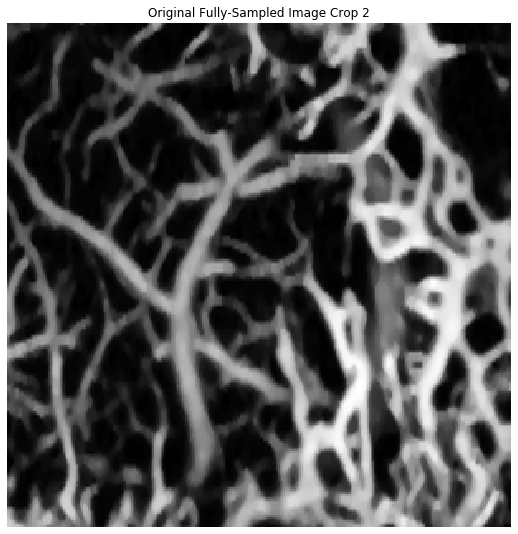

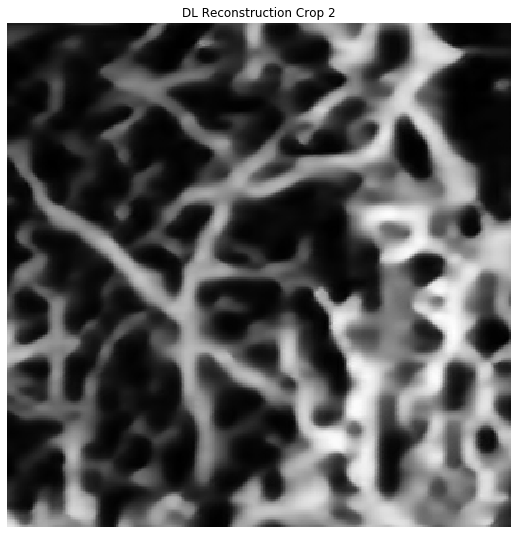

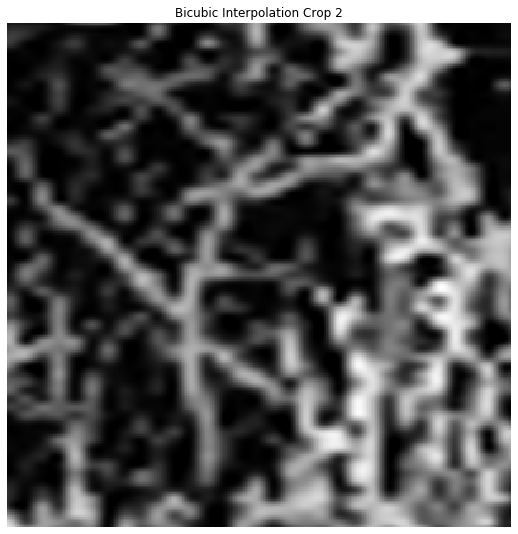

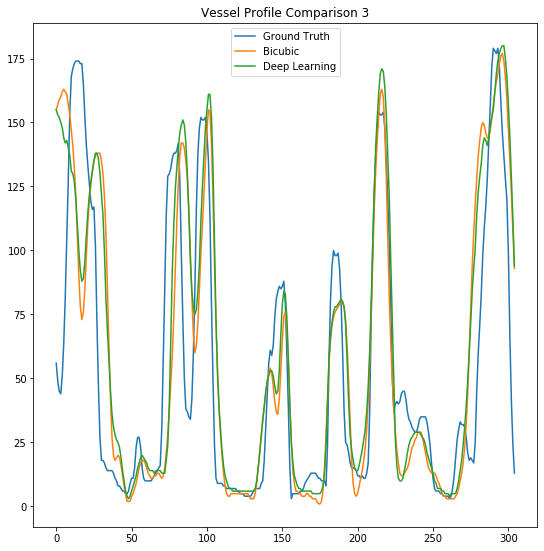

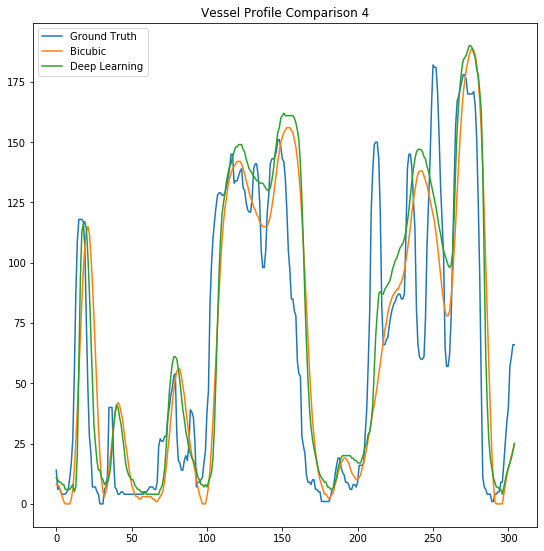

In [69]:
'''
IMAGE 2:
'''
ratio_0 = 1025/1280
ratio_1 = 720/1280
ratio_2 = 1405/2048
ratio_3 = 1100/2048

filename = 'deep_image_crop_2.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img.shape
latent_shape = latent_image.shape
deep_image_crop = deep_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, deep_image_crop, format='.png', compress_level=0)
filename = 'interp_img_crop_2.png'
filepath = os.path.join(directory, filename)
interp_img_crop = interp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, interp_img_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_2.png'
filepath = os.path.join(directory, filename)
latent_image_crop = latent_image[int(latent_shape[0]-(ratio_0*latent_shape[0])):int(latent_shape[0]-(ratio_1*latent_shape[0])),
                             int(latent_shape[1]-(ratio_2*latent_shape[1])):int(latent_shape[1]-(ratio_3*latent_shape[1]))]
imageio.imwrite(filepath, latent_image_crop, format='.png', compress_level=0)
filename = 'full_img_crop_2.png'
filepath = os.path.join(directory, filename)
full_samp_img_crop = full_samp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                                   int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, full_samp_img_crop, format='.png', compress_level=0)

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img_crop, cmap = 'gray')
plt.title('Original Fully-Sampled Image Crop 2')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image_crop, cmap = 'gray')
plt.title('DL Reconstruction Crop 2')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 2')
plt.show()

# Showing Vessel Profiles

DISP_CONV_FACTOR = 8.2 # converts pixels to micron

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[:, x_shape//2], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[:, x_shape//2],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[:, x_shape//2])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'])
#plt.title('Vessel Profile Comparison 3')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[y_shape//3, :], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[y_shape//3, :],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[y_shape//3, :])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'])
#plt.title('Vessel Profile Comparison 4')
plt.xlabel('Distance ($\mu$m)', fontsize=18)
plt.ylabel('Normalized PA Amplitude', fontsize=18)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


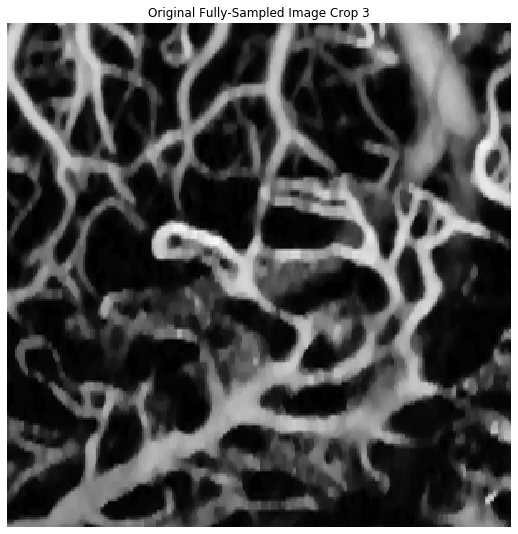

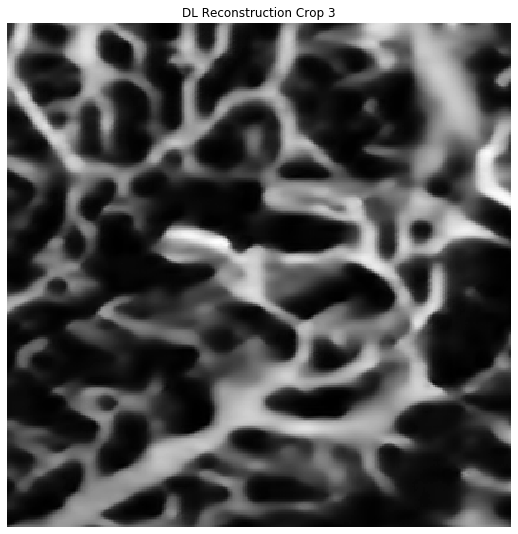

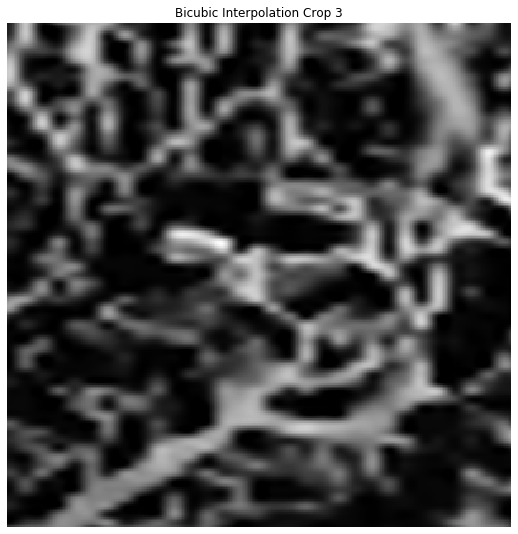

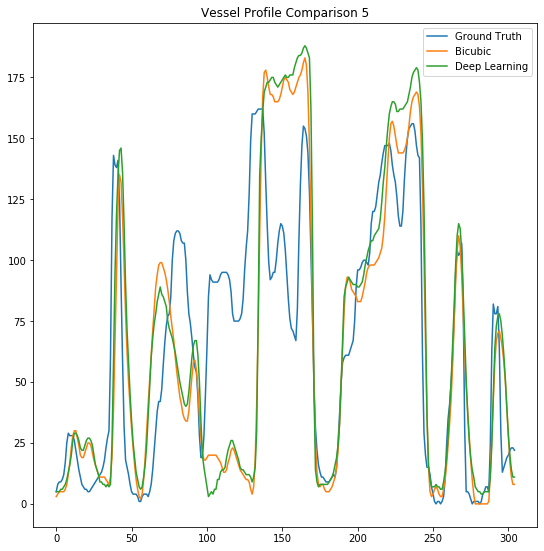

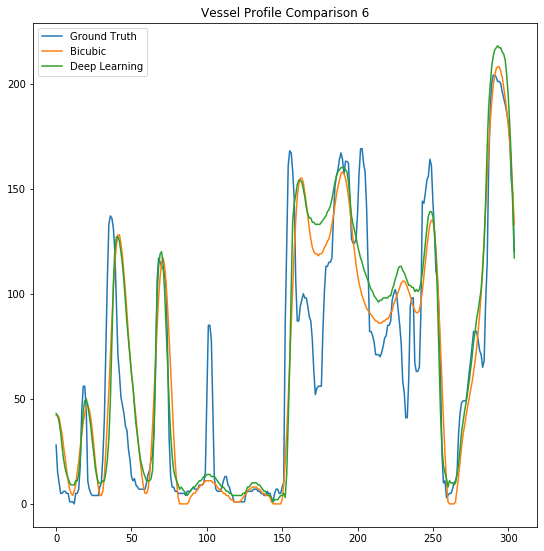

In [70]:
'''
IMAGE 3:
'''
ratio_0 = 525/1280
ratio_1 = 220/1280
ratio_2 = 1405/2048
ratio_3 = 1100/2048

filename = 'deep_image_crop_3.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img_pad.shape
latent_shape = latent_image_pad.shape
deep_image_crop = deep_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, deep_image_crop, format='.png', compress_level=0)
filename = 'interp_img_crop_3.png'
filepath = os.path.join(directory, filename)
interp_img_crop = interp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, interp_img_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_3.png'
filepath = os.path.join(directory, filename)
latent_image_crop = latent_image[int(latent_shape[0]-(ratio_0*latent_shape[0])):int(latent_shape[0]-(ratio_1*latent_shape[0])),
                             int(latent_shape[1]-(ratio_2*latent_shape[1])):int(latent_shape[1]-(ratio_3*latent_shape[1]))]
imageio.imwrite(filepath, latent_image_crop, format='.png', compress_level=0)
filename = 'full_img_crop_3.png'
filepath = os.path.join(directory, filename)
full_samp_img_crop = full_samp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                                   int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, full_samp_img_crop, format='.png', compress_level=0)

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img_crop, cmap = 'gray')
plt.title('Original Fully-Sampled Image Crop 3')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image_crop, cmap = 'gray')
plt.title('DL Reconstruction Crop 3')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 3')
plt.show()

# Showing Vessel Profiles

DISP_CONV_FACTOR = 8.2 # converts pixels to micron

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[:, x_shape//2], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[:, x_shape//2],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[:, x_shape//2])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'])
#plt.title('Vessel Profile Comparison 5')
plt.xlabel('Distance ($\mu$m)', fontsize=18)
plt.ylabel('Normalized PA Amplitude', fontsize=18)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[y_shape//3, :], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[y_shape//3, :],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[y_shape//3, :])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'])
#plt.title('Vessel Profile Comparison 6')
plt.xlabel('Distance ($\mu$m)', fontsize=18)
plt.ylabel('Normalized PA Amplitude', fontsize=18)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


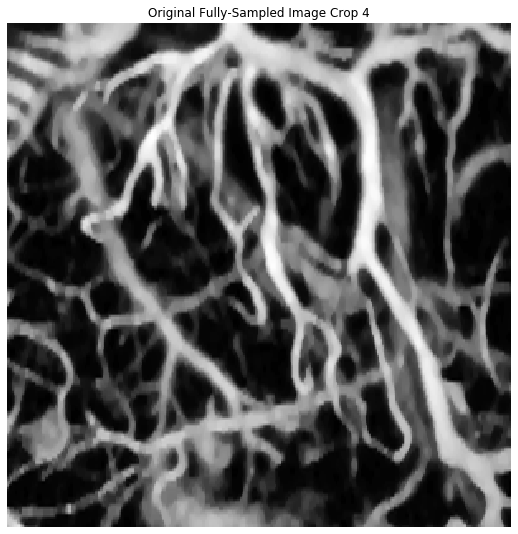

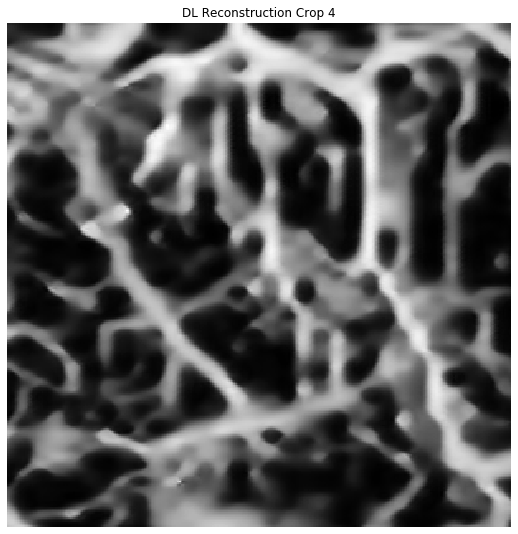

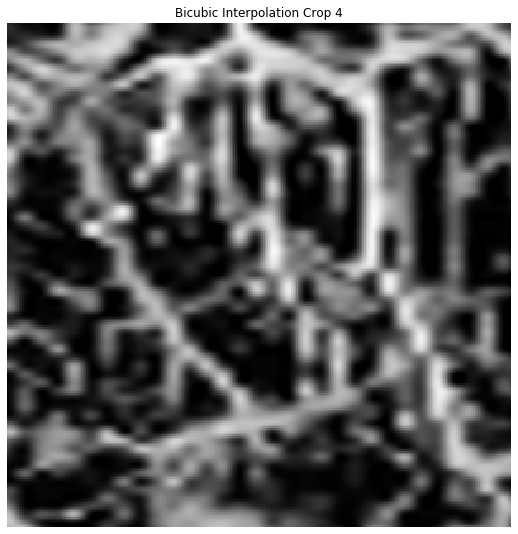

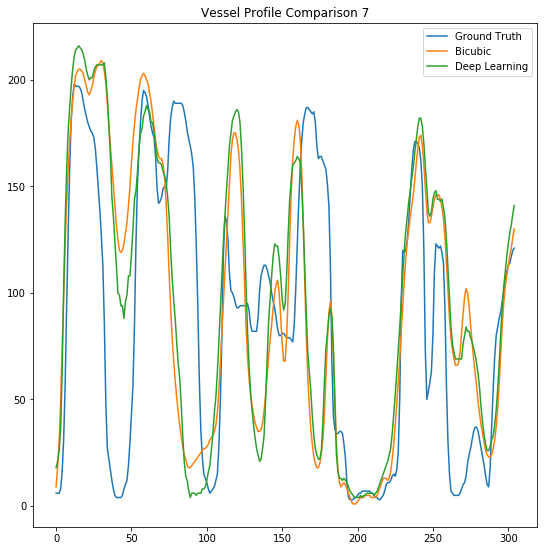

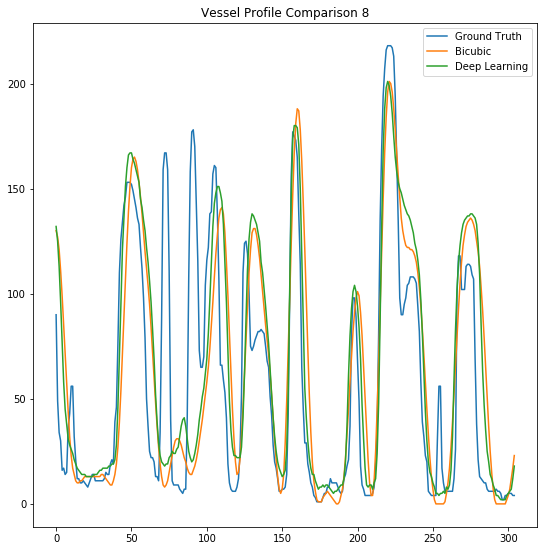

In [71]:
'''
IMAGE 4:
'''
ratio_0 = 625/1280
ratio_1 = 320/1280
ratio_2 = 935/2048
ratio_3 = 630/2048

filename = 'deep_image_crop_4.png'
filepath = os.path.join(directory, filename)
shape = full_samp_img_pad.shape
latent_shape = latent_image_pad.shape
deep_image_crop = deep_image[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, deep_image_crop, format='.png', compress_level=0)
filename = 'interp_img_crop_4.png'
filepath = os.path.join(directory, filename)
interp_img_crop = interp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                             int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, interp_img_crop, format='.png', compress_level=0)
filename = 'latent_image_crop_4.png'
filepath = os.path.join(directory, filename)
latent_image_crop = latent_image[int(latent_shape[0]-(ratio_0*latent_shape[0])):int(latent_shape[0]-(ratio_1*latent_shape[0])),
                             int(latent_shape[1]-(ratio_2*latent_shape[1])):int(latent_shape[1]-(ratio_3*latent_shape[1]))]
imageio.imwrite(filepath, latent_image_crop, format='.png', compress_level=0)
filename = 'full_img_crop_4.png'
filepath = os.path.join(directory, filename)
full_samp_img_crop = full_samp_img[int(shape[0]-(ratio_0*shape[0])):int(shape[0]-(ratio_1*shape[0])),
                                   int(shape[1]-(ratio_2*shape[1])):int(shape[1]-(ratio_3*shape[1]))]
imageio.imwrite(filepath, full_samp_img_crop, format='.png', compress_level=0)

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img_crop, cmap = 'gray')
plt.title('Original Fully-Sampled Image Crop 4')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image_crop, cmap = 'gray')
plt.title('DL Reconstruction Crop 4')
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img_crop, cmap = 'gray')
plt.title('Bicubic Interpolation Crop 4')
plt.show()

# Showing Vessel Profiles

DISP_CONV_FACTOR = 8.2 # converts pixels to micron

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[:, x_shape//2], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[:, x_shape//2],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[:, x_shape//2])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'])
#plt.title('Vessel Profile Comparison 7')
plt.xlabel('Distance ($\mu$m)', fontsize=18)
plt.ylabel('Normalized PA Amplitude', fontsize=18)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

figsize = (7,7)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
y_shape = full_samp_img_crop.shape[0]
x_shape = full_samp_img_crop.shape[1]
ax.plot(np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, full_samp_img_crop[y_shape//3, :], 
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, interp_img_crop[y_shape//3, :],
        np.arange(0, y_shape, 1)*DISP_CONV_FACTOR, deep_image_crop[y_shape//3, :])
ax.legend(['Ground Truth', 'Bicubic', 'Deep Learning'])
#plt.title('Vessel Profile Comparison 8')
plt.xlabel('Distance ($\mu$m)', fontsize=18)
plt.ylabel('Normalized PA Amplitude', fontsize=18)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 14)
plt.grid()
plt.show()

### Finding Statistical Results

In [ ]:
# Quantitative Measurements
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
#from model_utils import TV
deep_image = deep_image[..., None]
deep_image = tf.image.convert_image_dtype(deep_image[None, ...], tf.float32)
interp_img = interp_img[..., None]
interp_img = tf.image.convert_image_dtype(interp_img[None, ...], tf.float32)
full_samp_img = full_samp_img[..., None]
full_samp_img = tf.image.convert_image_dtype(full_samp_img[None, ...], tf.float32)
print('---------------------------------------')
print('##########LIST OF STATISTICS:##########')
print('---------------------------------------')
print('COMPARISON OF PSNR:')
print('Deep Learning: ' + str(PSNR(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(PSNR(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF SSIM:')
print('Deep Learning: ' + str(SSIM(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(SSIM(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF MEAN ABSOLUTE ERROR:')
MAE = tf.keras.losses.MeanAbsoluteError()
print('Deep Learning: ' + str(MAE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MAE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED ERROR:')
MSE = tf.keras.losses.MeanSquaredError()
print('Deep Learning: ' + str(MSE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSE(full_samp_img, interp_img).numpy()))
#print('COMPARISON OF TOTAL VARIATION:')
#print('Deep Learning: ' + str(TV(full_samp_img, deep_image).numpy()))
#print('Bicubic Interp: ' + str(TV(full_samp_img, interp_img).numpy()))
print('COMPARISON OF KL DIVERGENCE:')
print('Deep Learning: ' + str(KLDivergence(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(KLDivergence(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:')
MSLE = tf.keras.losses.MeanSquaredLogarithmicError()
print('Deep Learning: ' + str(MSLE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSLE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF LOG COSH ERROR:')
LCOSH = tf.keras.losses.LogCosh()
print('Deep Learning: ' + str(LCOSH(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(LCOSH(full_samp_img, interp_img).numpy()))
print('COMPARISON OF POISSON LOSS:')
PL = tf.keras.losses.Poisson()
print('Deep Learning: ' + str(PL(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(PL(full_samp_img, interp_img).numpy()))

# Collecting Test Statistics for All of the Test Image Dataset:

## Load Model

In [7]:
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
print('Loading Model...')
input_dir = 'saved_model_FD_UNet_3i-7j_down\\best_models'
filename = sorted(os.listdir(input_dir), key = lambda x : int(x.partition('h_')[2].partition('-S')[0]))[-1]
directory = os.path.join(os.getcwd(), input_dir)
directory = os.path.join(directory, filename)
saved_model = tf.keras.models.load_model(directory, custom_objects={'model_loss':model_loss,'loss_func':model_loss(B1=0.99,B2=0.01), 
                                                                    'PSNR':PSNR, 'SSIM':SSIM, 'KLDivergence':KLDivergence, 
                                                                    'SavingMetric':SavingMetric})
print('Done Loading Best Model (' + filename + ') from: ' + input_dir)

Loading Model...
Done Loading Best Model (saved_model.epoch_358-SSIM_0.85769-PSNR_27.74997-metric_0.17856.h5) from: saved_model_FD_UNet_3i-7j_down_v2\best_models


## Obtain Test Statistics

In [8]:
# Import Statements:
import test_statistics
from test_statistics import obtain_test_stats

In [ ]:
# Calculating Test Statistics:
model = saved_model
input_dir = 'data_1\\test\\input'
output_dir = 'output_imgs-7_3'
file_format = '.png'
downsampling_ratio = (3,7)
contrast_enhance = (0.01, 99.99)
interp = False # If you want to use bicubic pre-reconstruction
gauss_blur_std = None
stats = obtain_test_stats(model, input_dir, downsampling_ratio, 
                          contrast_enhance=contrast_enhance, 
                          interp=interp, gauss_blur_std=gauss_blur_std,
                          output_dir = output_dir, file_format = file_format)

In [36]:
metric = 'MEAN ABSOLUTE ERROR'
mean = np.mean(np.array(stats['Deep Learning'][metric]))
stdev = np.std(np.array(stats['Deep Learning'][metric]))
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(np.array(stats['Bicubic Interpolation'][metric]))
stdev = np.std(np.array(stats['Bicubic Interpolation'][metric]))
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

Deep Learning (mean): 0.023096488788723946
Deep Learning (sd): 0.0063142068684101105
Bicubic Interpolation (mean): 0.03528822585940361
Bicubic Interpolation (sd): 0.012321565300226212


In [33]:
metric = 'SSIM'
mean = np.mean(np.array(stats['Deep Learning'][metric]))
stdev = np.std(np.array(stats['Deep Learning'][metric]))
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(np.array(stats['Bicubic Interpolation'][metric]))
stdev = np.std(np.array(stats['Bicubic Interpolation'][metric]))
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

Deep Learning (mean): 0.8595378994941711
Deep Learning (sd): 0.031280066817998886
Bicubic Interpolation (mean): 0.7804045081138611
Bicubic Interpolation (sd): 0.06142544746398926


In [34]:
metric = 'PSNR'
mean = np.mean(np.array(stats['Deep Learning'][metric]))
stdev = np.std(np.array(stats['Deep Learning'][metric]))
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(np.array(stats['Bicubic Interpolation'][metric]))
stdev = np.std(np.array(stats['Bicubic Interpolation'][metric]))
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

Deep Learning (mean): 26.75696563720703
Deep Learning (sd): 2.0441529750823975
Bicubic Interpolation (mean): 23.74596405029297
Bicubic Interpolation (sd): 2.2485766410827637


## Save Stats Results to CSV

In [10]:
directory = 'stats_data'
if not os.path.exists(directory):
    os.mkdir(directory)
stats_df_dl = pd.DataFrame.from_dict(stats['Deep Learning'])
stats_df_bc = pd.DataFrame.from_dict(stats['Bicubic Interpolation'])
stats_df_dl.to_csv(f'{directory}/stats_{downsampling_ratio[0]}i-{downsampling_ratio[1]}j_down_dl.csv', index=False)
stats_df_bc.to_csv(f'{directory}/stats_{downsampling_ratio[0]}i-{downsampling_ratio[1]}j_down_bc.csv', index=False)
print('Done Saving!!!')

Done Saving!!!


## Graph Model Performance versus Downsampling Ratio

In [3]:
directory = 'stats_data'
metrics = ['Method','Downsampling Ratio','PSNR', 'SSIM', 'MEAN ABSOLUTE ERROR', 'MEAN SQUARED ERROR']
stats_df = pd.DataFrame(columns=metrics)
index = 0
for i in range(len(os.listdir(directory))):
    filename = os.listdir(directory)[i]
    if filename != '.ipynb_checkpoints':
        filepath = os.path.join(directory, filename)
        data = pd.read_csv(filepath)
        down_ratio = re.findall("\d+", filename)
        down_ratio = [ele for ele in reversed(down_ratio)] 
        down_ratio = [int(j) for j in down_ratio]
        if filename[-6:-4] == 'dl':
            model_type = 'Deep Learning'
        else:
            model_type = 'Bicubic Interpolation'
        data_df = data[data.columns[:-4]]
        data_df.insert(0, 'Method', model_type)
        data_df.insert(1, 'Downsampling Ratio', str(down_ratio))
        stats_df = pd.concat([stats_df, data_df], ignore_index=True)

In [4]:
stats_df

,Method,Downsampling Ratio,PSNR,SSIM,MEAN ABSOLUTE ERROR,MEAN SQUARED ERROR
0,Deep Learning,"[5, 1]",31.952326,0.938787,0.011222,0.000638
1,Deep Learning,"[5, 1]",30.212088,0.925464,0.014611,0.000952
2,Deep Learning,"[5, 1]",31.853550,0.934565,0.011324,0.000653
3,Deep Learning,"[5, 1]",31.087646,0.929425,0.015959,0.000778
4,Deep Learning,"[5, 1]",25.598269,0.883380,0.020989,0.002755
...,...,...,...,...,...,...
169,Bicubic Interpolation,"[10, 5]",18.857828,0.613842,0.066311,0.012992
170,Bicubic Interpolation,"[10, 5]",18.000860,0.584237,0.070055,0.015846
171,Bicubic Interpolation,"[10, 5]",21.969118,0.743819,0.039014,0.006189
172,Bicubic Interpolation,"[10, 5]",22.509470,0.655418,0.038542,0.005547


### Finding Stats for [1, 5]

In [5]:
stats_df_1_5 = stats_df.loc[stats_df['Downsampling Ratio'] == '[5, 1]']
stats_df_1_5_dl = stats_df_1_5.loc[stats_df_1_5['Method'] == 'Deep Learning'][['PSNR', 'SSIM', 'MEAN ABSOLUTE ERROR', 'MEAN SQUARED ERROR']]
stats_df_1_5_bc = stats_df_1_5.loc[stats_df_1_5['Method'] == 'Bicubic Interpolation'][['PSNR', 'SSIM', 'MEAN ABSOLUTE ERROR', 'MEAN SQUARED ERROR']]
# PSNR
metric = 'PSNR'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_1_5_dl[metric])
stdev = np.std(stats_df_1_5_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_1_5_bc[metric])
stdev = np.std(stats_df_1_5_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

# SSIM
metric = 'SSIM'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_1_5_dl[metric])
stdev = np.std(stats_df_1_5_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_1_5_bc[metric])
stdev = np.std(stats_df_1_5_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

# MAE
metric = 'MEAN ABSOLUTE ERROR'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_1_5_dl[metric])
stdev = np.std(stats_df_1_5_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_1_5_bc[metric])
stdev = np.std(stats_df_1_5_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

# MSE
metric = 'MEAN SQUARED ERROR'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_1_5_dl[metric])
stdev = np.std(stats_df_1_5_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_1_5_bc[metric])
stdev = np.std(stats_df_1_5_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')
print('\n-----------END-----------\n')


-----------PSNR-----------
Deep Learning (mean): 30.367293982670226
Deep Learning (sd): 2.0206873729489727
Bicubic Interpolation (mean): 25.787236706963903
Bicubic Interpolation (sd): 2.2111667304797864

-----------SSIM-----------
Deep Learning (mean): 0.9231596794621698
Deep Learning (sd): 0.019461852385611687
Bicubic Interpolation (mean): 0.844502422316321
Bicubic Interpolation (sd): 0.04721393690729453

-----------MEAN ABSOLUTE ERROR-----------
Deep Learning (mean): 0.014429075514961934
Deep Learning (sd): 0.0038008199748128563
Bicubic Interpolation (mean): 0.02671290584037016
Bicubic Interpolation (sd): 0.008621773398187219

-----------MEAN SQUARED ERROR-----------
Deep Learning (mean): 0.0010338984911554847
Deep Learning (sd): 0.0005794637900575378
Bicubic Interpolation (mean): 0.0029842507029915677
Bicubic Interpolation (sd): 0.0014750669654233317

-----------END-----------



### Finding Stats for [3, 7]

In [6]:
stats_df_3_7 = stats_df.loc[stats_df['Downsampling Ratio'] == '[7, 3]']
stats_df_3_7_dl = stats_df_3_7.loc[stats_df_3_7['Method'] == 'Deep Learning'][['PSNR', 'SSIM', 'MEAN ABSOLUTE ERROR', 'MEAN SQUARED ERROR']]
stats_df_3_7_bc = stats_df_3_7.loc[stats_df_3_7['Method'] == 'Bicubic Interpolation'][['PSNR', 'SSIM', 'MEAN ABSOLUTE ERROR', 'MEAN SQUARED ERROR']]
# PSNR
metric = 'PSNR'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_3_7_dl[metric])
stdev = np.std(stats_df_3_7_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_3_7_bc[metric])
stdev = np.std(stats_df_3_7_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

# SSIM
metric = 'SSIM'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_3_7_dl[metric])
stdev = np.std(stats_df_3_7_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_3_7_bc[metric])
stdev = np.std(stats_df_3_7_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

# MAE
metric = 'MEAN ABSOLUTE ERROR'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_3_7_dl[metric])
stdev = np.std(stats_df_3_7_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_3_7_bc[metric])
stdev = np.std(stats_df_3_7_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

# MSE
metric = 'MEAN SQUARED ERROR'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_3_7_dl[metric])
stdev = np.std(stats_df_3_7_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_3_7_bc[metric])
stdev = np.std(stats_df_3_7_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')
print('\n-----------END-----------\n')


-----------PSNR-----------
Deep Learning (mean): 26.87428329730856
Deep Learning (sd): 1.973723434233147
Bicubic Interpolation (mean): 23.74596227448562
Bicubic Interpolation (sd): 2.2485766305754615

-----------SSIM-----------
Deep Learning (mean): 0.8536915799667095
Deep Learning (sd): 0.038197111447418525
Bicubic Interpolation (mean): 0.7804044916712004
Bicubic Interpolation (sd): 0.06142544616938328

-----------MEAN ABSOLUTE ERROR-----------
Deep Learning (mean): 0.022790365049551273
Deep Learning (sd): 0.0061439488405351786
Bicubic Interpolation (mean): 0.03528822560248704
Bicubic Interpolation (sd): 0.012321564946855162

-----------MEAN SQUARED ERROR-----------
Deep Learning (mean): 0.0022681160119426406
Deep Learning (sd): 0.0010382702891833916
Bicubic Interpolation (mean): 0.004811056993965958
Bicubic Interpolation (sd): 0.0025503510845915536

-----------END-----------



### Finding Stats for [5, 10]

In [7]:
stats_df_5_10 = stats_df.loc[stats_df['Downsampling Ratio'] == '[10, 5]']
stats_df_5_10_dl = stats_df_5_10.loc[stats_df_5_10['Method'] == 'Deep Learning'][['PSNR', 'SSIM', 'MEAN ABSOLUTE ERROR', 'MEAN SQUARED ERROR']]
stats_df_5_10_bc = stats_df_5_10.loc[stats_df_5_10['Method'] == 'Bicubic Interpolation'][['PSNR', 'SSIM', 'MEAN ABSOLUTE ERROR', 'MEAN SQUARED ERROR']]
# PSNR
metric = 'PSNR'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_5_10_dl[metric])
stdev = np.std(stats_df_5_10_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_5_10_bc[metric])
stdev = np.std(stats_df_5_10_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

# SSIM
metric = 'SSIM'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_5_10_dl[metric])
stdev = np.std(stats_df_5_10_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_5_10_bc[metric])
stdev = np.std(stats_df_5_10_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

# MAE
metric = 'MEAN ABSOLUTE ERROR'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_5_10_dl[metric])
stdev = np.std(stats_df_5_10_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_5_10_bc[metric])
stdev = np.std(stats_df_5_10_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')

# MSE
metric = 'MEAN SQUARED ERROR'
print(f'\n-----------{metric}-----------')
mean = np.mean(stats_df_5_10_dl[metric])
stdev = np.std(stats_df_5_10_dl[metric])
print(f'Deep Learning (mean): {mean}')
print(f'Deep Learning (sd): {stdev}')
mean = np.mean(stats_df_5_10_bc[metric])
stdev = np.std(stats_df_5_10_bc[metric])
print(f'Bicubic Interpolation (mean): {mean}')
print(f'Bicubic Interpolation (sd): {stdev}')
print('\n-----------END-----------\n')


-----------PSNR-----------
Deep Learning (mean): 23.630011196794182
Deep Learning (sd): 1.791562756018032
Bicubic Interpolation (mean): 20.273654214267072
Bicubic Interpolation (sd): 1.9834737786447316

-----------SSIM-----------
Deep Learning (mean): 0.7818235241133591
Deep Learning (sd): 0.045586867081140174
Bicubic Interpolation (mean): 0.6510413165750175
Bicubic Interpolation (sd): 0.07630414112854034

-----------MEAN ABSOLUTE ERROR-----------
Deep Learning (mean): 0.03334802241417868
Deep Learning (sd): 0.008524952697441465
Bicubic Interpolation (mean): 0.055088698863983154
Bicubic Interpolation (sd): 0.01518791130176114

-----------MEAN SQUARED ERROR-----------
Deep Learning (mean): 0.004688738981775683
Deep Learning (sd): 0.0018070617074173974
Bicubic Interpolation (mean): 0.01024944640310674
Bicubic Interpolation (sd): 0.00409372694723

-----------END-----------



### Creating Figure Comparing Model Performance vs. Downsampling Ratio

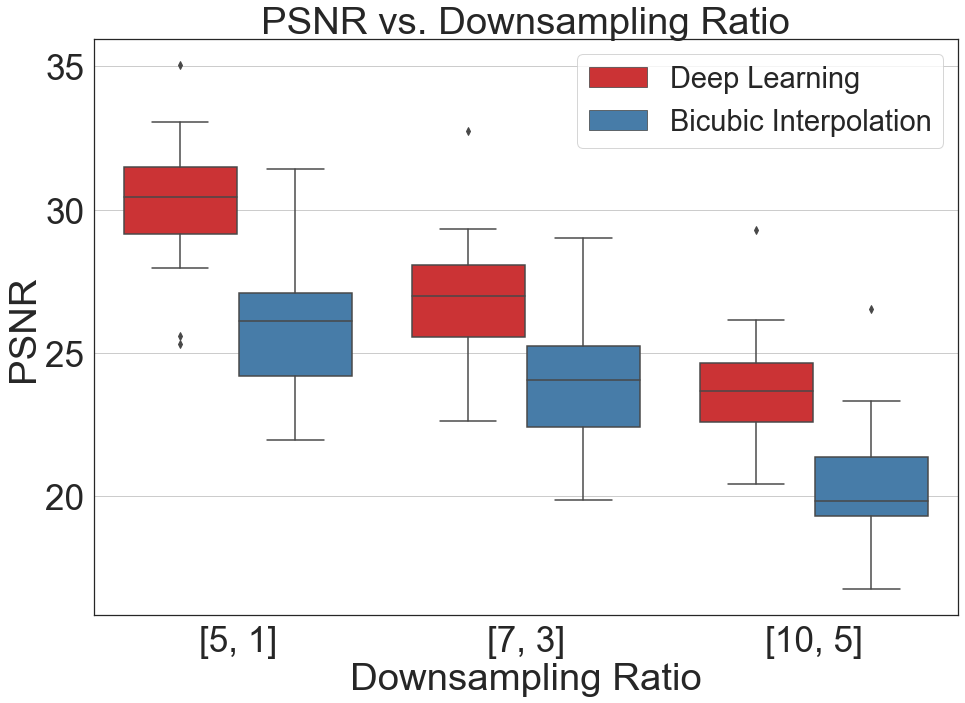

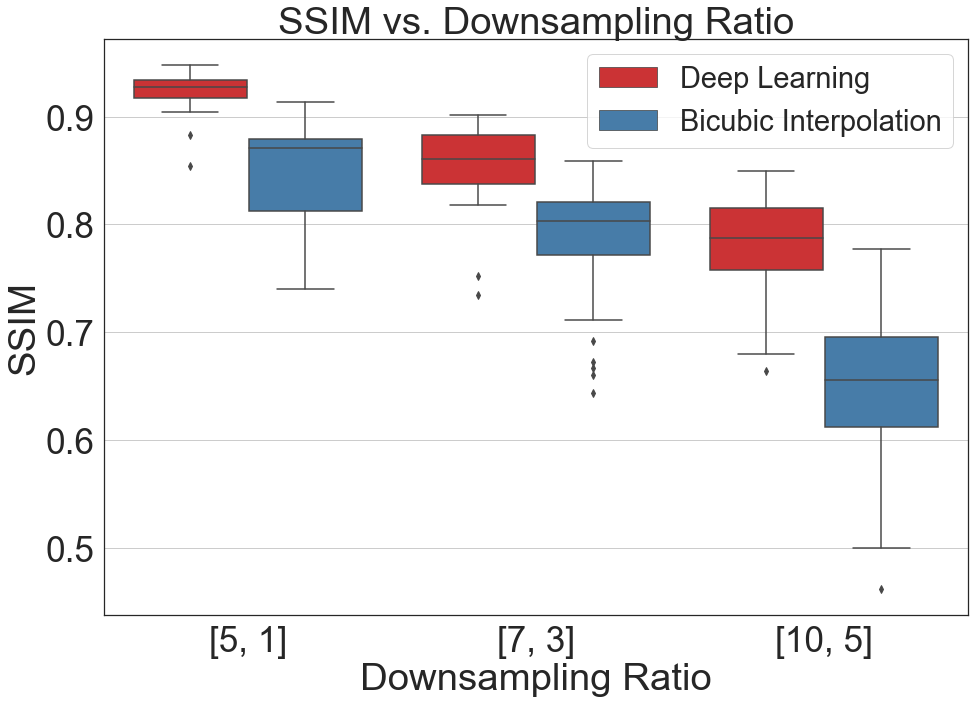

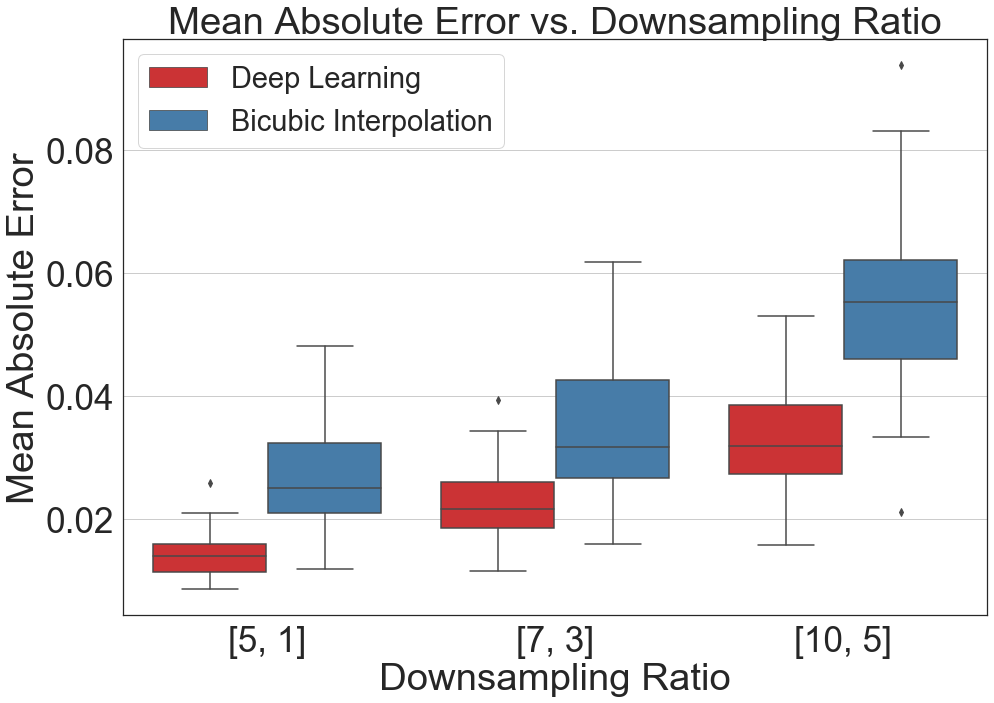

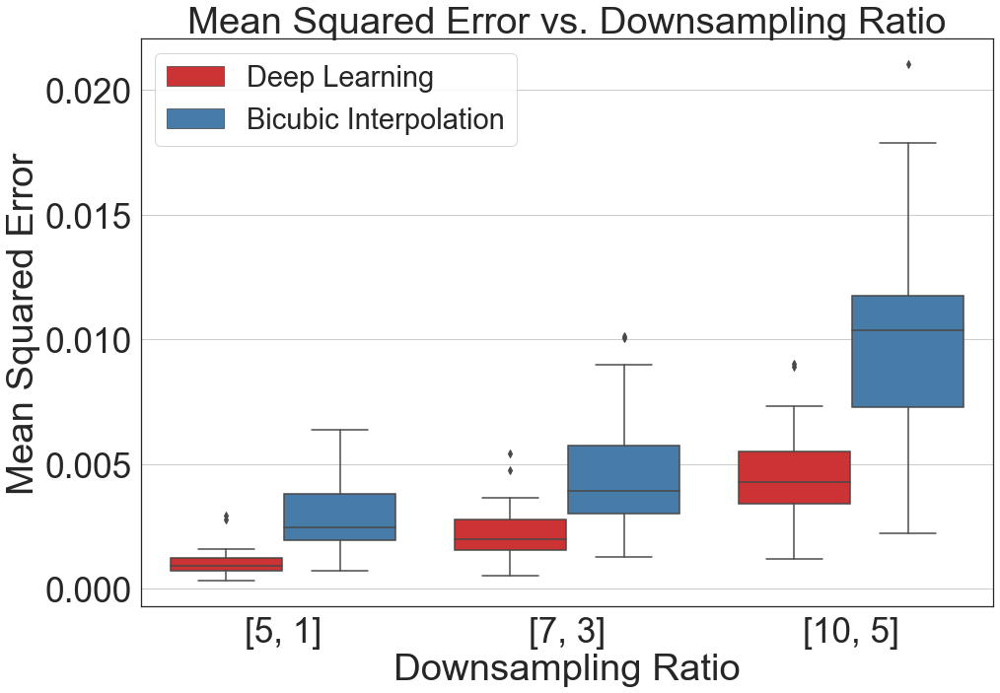

In [10]:
directory = 'stats_compare_figs'
if not os.path.exists(directory):
    os.mkdir(directory)
scale = 3.2
figsize = (15,10)
LEGEND_SIZE = 29
# PSNR Plot
sns.set_style(style='white')
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0.14,0.14,0.8,0.8])
sns.set(font_scale=scale) 
sns.boxplot(x='Downsampling Ratio', y='PSNR', hue='Method', 
            data=stats_df.loc[:,['Method', 'Downsampling Ratio', 'PSNR']], 
            order=['[5, 1]', '[7, 3]', '[10, 5]'], palette='Set1')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles[0:], labels=labels[0:], fontsize=LEGEND_SIZE, facecolor='white')
plt.title('PSNR vs. Downsampling Ratio')
plt.grid(axis='y')
filename = 'PSNR.png'
filepath = os.path.join(directory, filename)
plt.savefig(filepath, dpi=400)
plt.show()

# SSIM Plot
sns.set_style(style='white')
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0.14,0.14,0.8,0.8])
sns.set(font_scale=scale)
sns.boxplot(x='Downsampling Ratio', y='SSIM', hue='Method', 
            data=stats_df.loc[:,['Method', 'Downsampling Ratio', 'SSIM']], 
            order=['[5, 1]', '[7, 3]', '[10, 5]'], palette='Set1')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles[0:], labels=labels[0:], fontsize=LEGEND_SIZE, facecolor='white')
plt.title('SSIM vs. Downsampling Ratio')
plt.grid(axis='y')
filename = 'SSIM.png'
filepath = os.path.join(directory, filename)
plt.savefig(filepath, dpi=400)
plt.show()

# Mean Absolute Error Plot
sns.set_style(style='white')
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0.14,0.14,0.8,0.8])
sns.set(font_scale=scale) 
sns.boxplot(x='Downsampling Ratio', y='MEAN ABSOLUTE ERROR', hue='Method', 
            data=stats_df.loc[:,['Method', 'Downsampling Ratio', 'MEAN ABSOLUTE ERROR']], 
            order=['[5, 1]', '[7, 3]', '[10, 5]'], palette='Set1')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles[0:], labels=labels[0:], fontsize=LEGEND_SIZE, facecolor='white')
plt.title('Mean Absolute Error vs. Downsampling Ratio')
plt.ylabel('Mean Absolute Error')
plt.grid(axis='y')
filename = 'MAE.png'
filepath = os.path.join(directory, filename)
plt.savefig(filepath, dpi=400)
plt.show()

# Mean Squared Error Plot
sns.set_style(style='white')
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0.14,0.14,0.8,0.8])
sns.set(font_scale=scale) 
sns.boxplot(x='Downsampling Ratio', y='MEAN SQUARED ERROR', hue='Method', 
            data=stats_df.loc[:,['Method', 'Downsampling Ratio', 'MEAN SQUARED ERROR']], 
            order=['[5, 1]', '[7, 3]', '[10, 5]'], palette='Set1')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles[0:], labels=labels[0:], fontsize=LEGEND_SIZE, facecolor='white')
plt.title('Mean Squared Error vs. Downsampling Ratio')
plt.ylabel('Mean Squared Error')
plt.grid(axis='y')
filename = 'MSE.png'
filepath = os.path.join(directory, filename)
plt.savefig(filepath, dpi=400)
plt.show()

# Testing Zero-Fill Blur Results

In [27]:
# Import Statements
import patchwork_alg
from patchwork_alg import expand_image
from patchwork_alg import fix_boundaries
from patchwork_alg import apply_model_patchwork
from patchwork_alg import remove_peak
from patchwork_alg import remove_padding

Directory: patchwork_test\reslt_OR_9 (5)_index0_pad.tif
(401, 286)


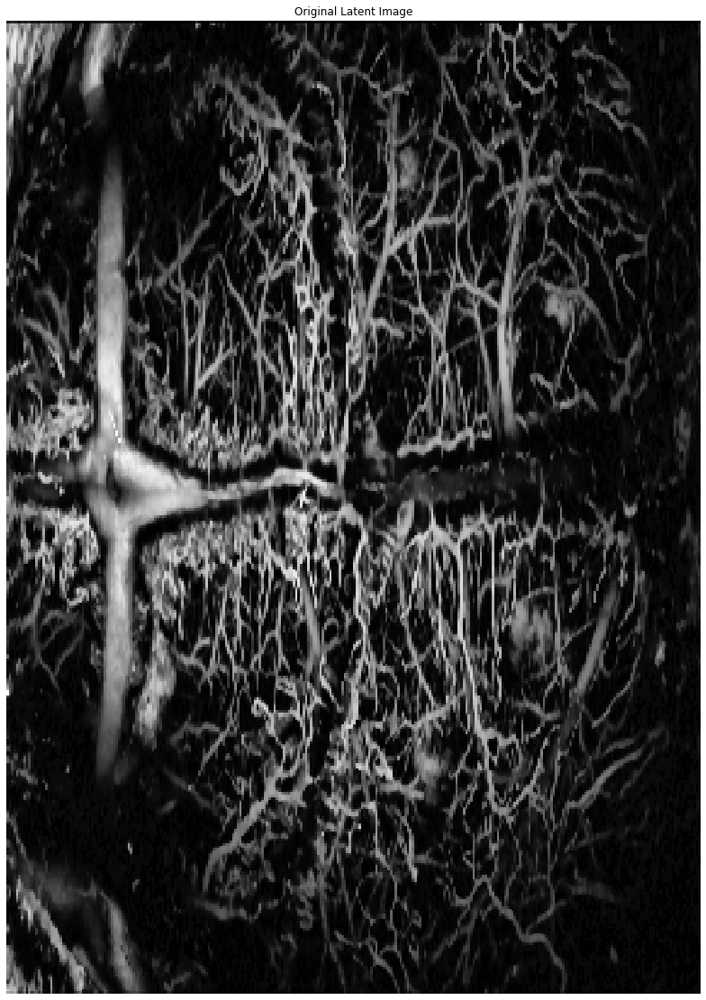

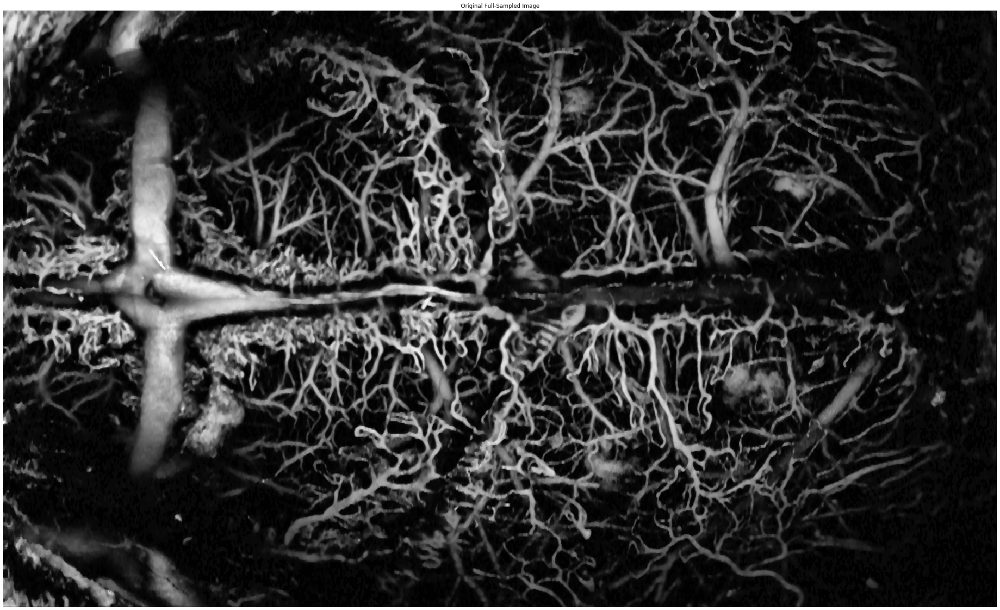

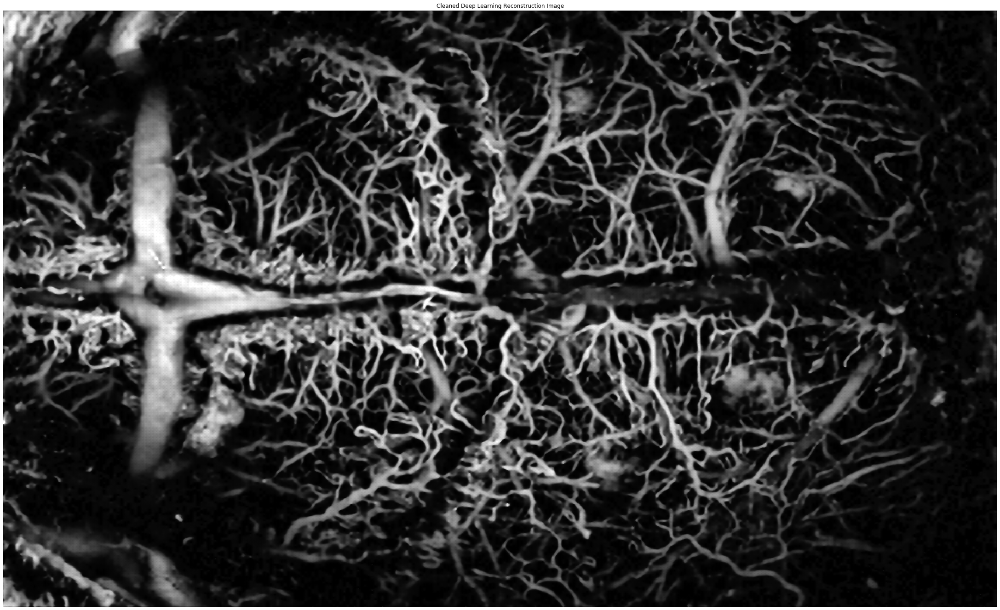

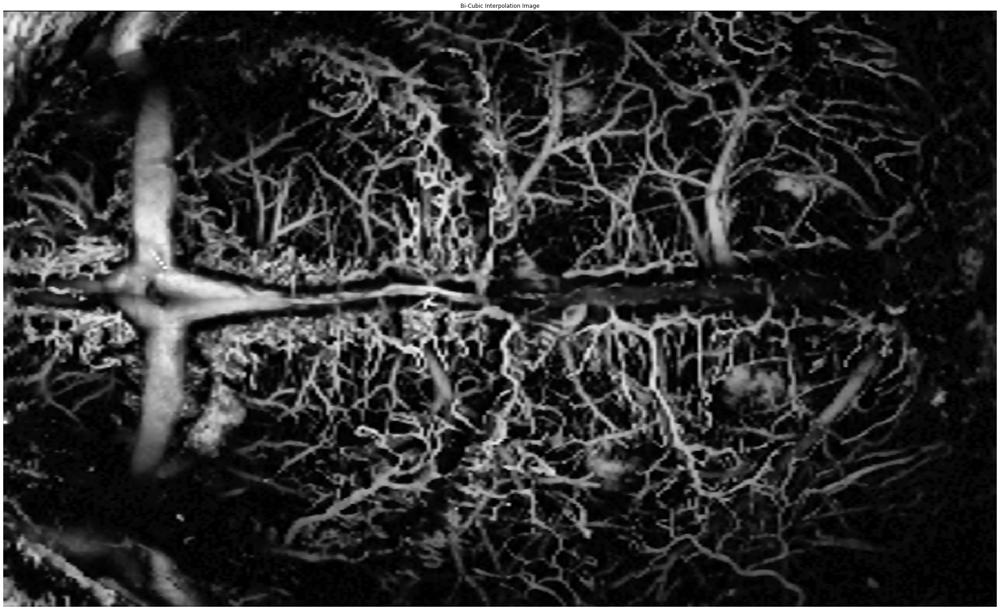

In [28]:
dir_name = 'patchwork_test'
#saved_model = best_unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,0], in_range='image', out_range=(0.0,1.0))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
# Resizing Images To Balance Downsampling Ratio Along Axes (one axis already downsampled in lab):
i_ratio = 2
j_ratio = 1
full_samp_img_shape = (full_samp_img.shape[0]*i_ratio, full_samp_img.shape[1]*j_ratio)
full_samp_img = skimage.transform.resize(full_samp_img, output_shape=full_samp_img_shape, order=3, 
                                         mode='reflect', cval=0, clip=True, preserve_range=True, 
                                         anti_aliasing=True, anti_aliasing_sigma=None)
full_samp_img_pad = full_samp_img

# Recover Latent Image (with pad):
downsampling_ratio = [3,7]
latent_image = np.zeros((int(np.ceil(full_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(full_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, full_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, full_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = full_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
latent_image_pad = latent_image

# Removing Image Border (if it exists)
full_samp_img = remove_padding(full_samp_img)

# Recover Latent Image (No Pad):
latent_image = np.zeros((int(np.ceil(full_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(full_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, full_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, full_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = full_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
print(latent_image.shape)
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image, cmap = 'gray')
plt.title('Original Latent Image')
plt.show()

figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Original Full-Sampled Image')
plt.show()
deep_image = apply_model_patchwork(saved_model, down_image = latent_image, downsampling_ratio = downsampling_ratio, 
                                   downsampling_axis = 'both', shape_for_model = (128,128), 
                                   buffer = 20, output_shape = full_samp_img.shape, remove_pad=False, gauss_blur_std=None)
deep_image = skimage.img_as_float(deep_image)
p1, p2 = np.percentile(deep_image, (0.05, 99.95))
deep_image = exposure.rescale_intensity(deep_image, in_range=(p1, p2), out_range=(0.0,1.0))
# figsize = (27,27)
# fig = plt.figure(figsize=figsize)
# ax = fig.add_axes([0, 0, 1, 1])
# ax.axis('off')
# ax.imshow(deep_image, cmap = 'gray')
# plt.title('Deep Learning Reconstruction Image')
# plt.show()
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Cleaned Deep Learning Reconstruction Image')
plt.show()

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
interp_img = skimage.transform.resize(latent_image, output_shape=full_samp_img.shape, 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, 
                                      anti_aliasing=True, anti_aliasing_sigma=None)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image')
plt.show()


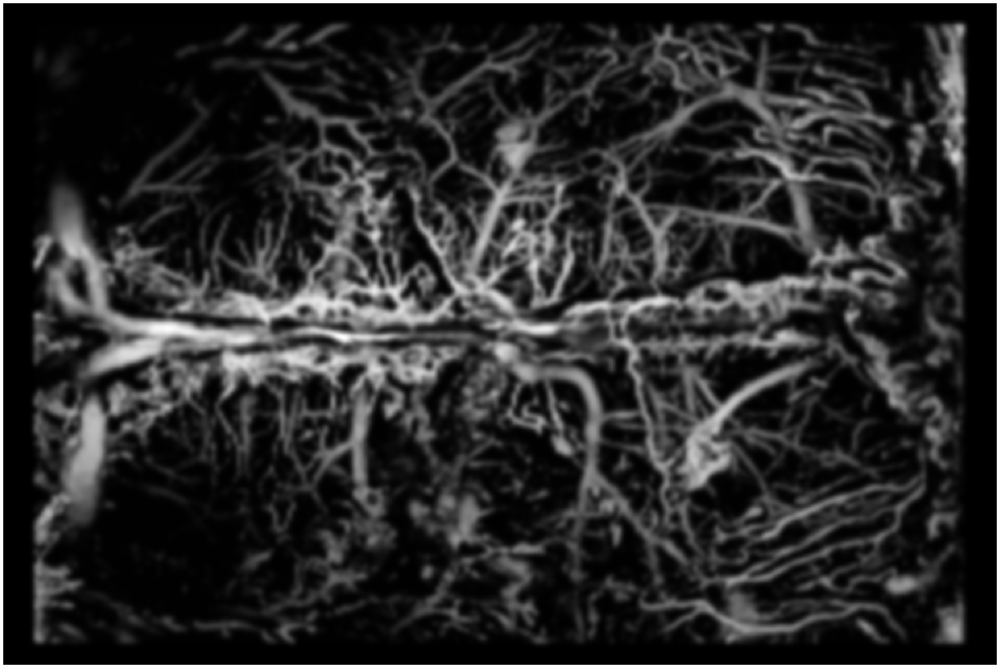

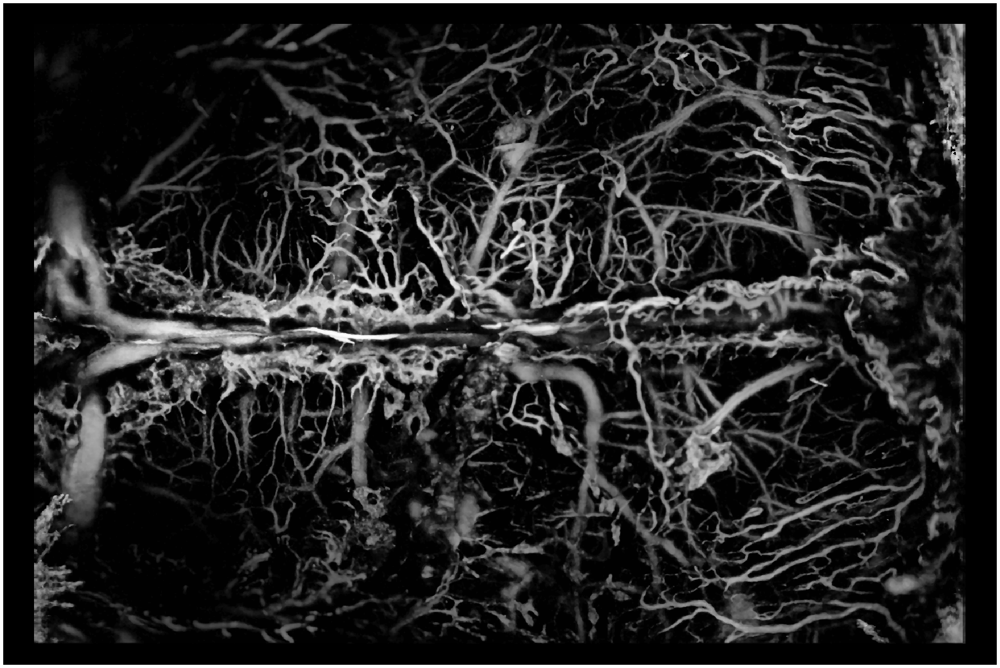

In [112]:
filepath = 'data_1/test/input/reslt_OR_9 (2)_index0_pad_3-7.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,1], in_range='image', out_range=(0.0,1.0))
full_samp_img = scipy.ndimage.gaussian_filter(full_samp_img, sigma=5, order=0, output=None, mode='reflect', cval=0.0, truncate=6.0)
full_samp_img = exposure.rescale_intensity(full_samp_img, in_range='image', out_range=(0.0,1.0))
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.show()
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(orig_img[...,0], cmap = 'gray')
plt.show()

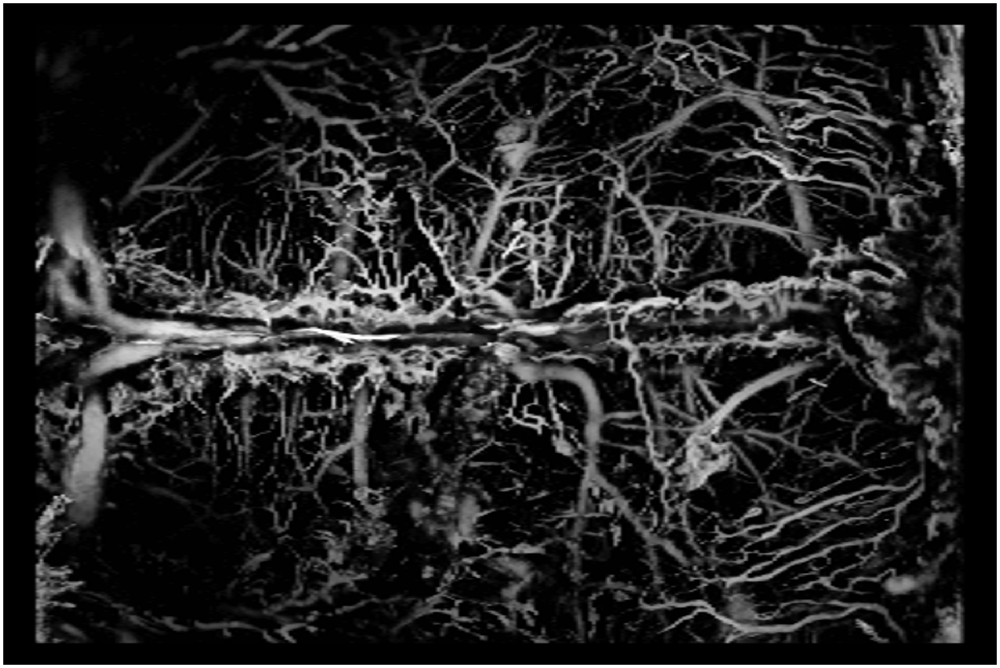

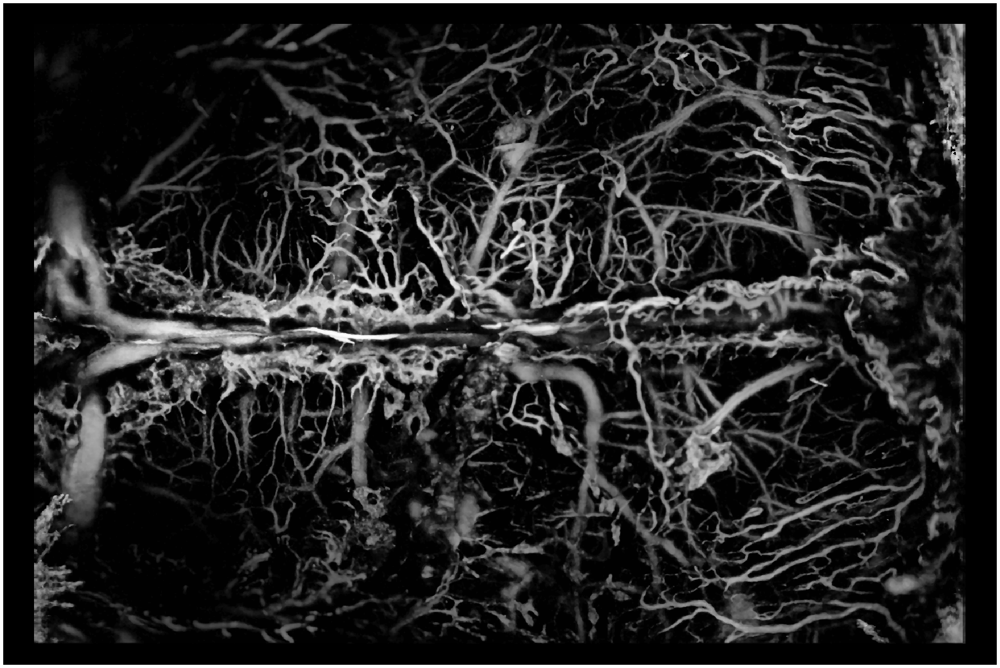

In [24]:
filepath = 'data_1/test/input/reslt_OR_9 (2)_index0_pad_3-7.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,1], in_range='image', out_range=(0.0,1.0))
#full_samp_img = scipy.ndimage.gaussian_filter(full_samp_img, sigma=5, order=0, output=None, mode='reflect', cval=0.0, truncate=6.0)
#full_samp_img = exposure.rescale_intensity(full_samp_img, in_range='image', out_range=(0.0,1.0))
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.show()
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(orig_img[...,0], cmap = 'gray')
plt.show()

# Saving Images in New Dir (without padding)

In [30]:
import remove_pad_save_to_new_dir
from remove_pad_save_to_new_dir import remove_pad_save_to_new_dir
OUTPUT_DIR = 'no_pad_data-5_1'
file_format = '.png'
NUM_IMAGES = 29

In [31]:
INPUT_DIR = 'data_1/test/input'
remove_pad_save_to_new_dir(INPUT_DIR, OUTPUT_DIR, file_format, NUM_IMAGES)
print('Done Saving!!!')

Done Saving!!!
